# **Sherlock Homes Dataset**

# Introduction

## About This Assignment

Design and implement a complete **Natural Language Processing (NLP)** pipeline for
advanced sequence-to-sequence tasks using the Sherlock Holmes dataset, including:
-  text summarisation
- semantic search
- thematic analysis

The focus is on understanding the process, implementing modular steps, and critically evaluating outcomes.

**Objective**

To write a comprehensive report detailing the development, findings, and
results of your (NLP) pipeline, focusing on:
- How design choices influenced performance.
- Challenges encountered at each stage.
- Insights gained from the dataset and NLP methods used.
- Suggest improvements for each component of the pipeline.


## About this Data

- This collection features all the stories and novels of Sherlock Holmes by Arthur Conan Doyle.
- Within the Sherlock folder, you'll find multiple .txt files, each containing a unique story.

# Importing neccesary libraries

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
import nltk

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Importing the dataset

In [ ]:
pip install opendatasets


In [ ]:
import opendatasets as od
import pandas

od.download(
	"https://www.kaggle.com/datasets/niteazi/sherlock-holmes")


In [ ]:
path = '/content/sherlock-holmes/sherlock/sherlock'

files = os.listdir(path)
stories = {}
files.sort(key=lambda x: int(os.path.splitext(x)[0]))  # Sort based on the numeric part of the filename  bc \os.listdir(path),sorts alphabetically (not numerically).

# Iterate over each file in the folder
for idx, file in enumerate(files):
    with open(os.path.join(path, file), 'r') as data:
        contents = data.read()
        stories[idx] = contents

#test
print(stories[1])
print(len(stories[1]))





                      THE ADVENTURE OF THE THREE GARRIDEBS

                               Arthur Conan Doyle



     It may have been a comedy, or it may have been a tragedy. It cost one
     man his reason, it cost me a blood-letting, and it cost yet another
     man the penalties of the law. Yet there was certainly an element of
     comedy. Well, you shall judge for yourselves.

     I remember the date very well, for it was in the same month that
     Holmes refused a knighthood for services which may perhaps some day
     be described. I only refer to the matter in passing, for in my
     position of partner and confidant I am obliged to be particularly
     careful to avoid any indiscretion. I repeat, however, that this
     enables me to fix the date, which was the latter end of June, 1902,
     shortly after the conclusion of the South African War. Holmes had
     spent several days in bed, as was his habit from time to time, but he
     emerged that morning with a long fo

In [ ]:
print(stories[11]) # loaded correctly if output is THE COMPLETE SHERLOCK HOLMES






                          THE COMPLETE SHERLOCK HOLMES

                               Arthur Conan Doyle



                                Table of contents

               A Study In Scarlet

               The Sign of the Four

                  The Adventures of Sherlock Holmes
               A Scandal in Bohemia
               The Red-Headed League
               A Case of Identity
               The Boscombe Valley Mystery
               The Five Orange Pips
               The Man with the Twisted Lip
               The Adventure of the Blue Carbuncle
               The Adventure of the Speckled Band
               The Adventure of the Engineer's Thumb
               The Adventure of the Noble Bachelor
               The Adventure of the Beryl Coronet
               The Adventure of the Copper Beeches

                  The Memoirs of Sherlock Holmes
               Silver Blaze
               The Yellow Face
               The Stock-Broker's Clerk
               The "Gloria 

# Task 1

Clean the Sherlock Holmes dataset to handle common text preprocessing challenges, provide a short report detailing preprocessing challenges and how they were addressed.

## Preprocessing Challenges

### Which are they?

First task of this assignment is to apply data preprocessing to the sherlock holmes dataset from common challenges. Given the complex nature of a literacy text, preprocessing is a crucial step before applying Deep Learning Models. To be fair, it could  be the most important as it is crucial of how the rest of the tasks are going to perform later on, as  it’s commonly said “garbage in garbage out”.

It is expected for the non-processed text to present the common preprocessing challenges of:
- inclusion of punctuation
- inclusion of uppercase letters
- duplicate stories ( a book can include a story but the story can be published by itself as well)
- variation of size between stories

Moreover, as it is a dataset of literacy texts the following challenges are also expected:

- inclusion of copyright text
- inclusion of the author and title
- multiple stories in one text file (some books include more than one stories sometimes)


### How were they addressed?

- There's no a one fits all preprocessing pipeline solution. Each task requires different preprocessing.
- As an example, there's tasks like topic modeling that require tokenization and stopword removal while others like text summarization require only removal of special characters, converting to lowercase and pretty much just removing unncessary information as retaining the complete sentence structure and entity names is critical for these tasks.
- According to the summary of week 2 at the blackboard of Deep learning module the following steps must be taken for **text preprocessing for NLP** :
  - **Tokenization:** Breaking down text into individual words or sentences (tokens).
  - **Text Cleaning:** Removing irrelevant information (stop words), standardizing words (stemming and lemmatization), and resolving ambiguity (POS tagging and text disambiguation).
  - **Text Embedding:** Transforming text tokens into numerical vector representations that capture semantic relationships between words.

- The steps mentioned above were turned into functions with parameters that could filter what preprocessing step to keep and what not to accomodate the fact that different tasks need different preprocessing steps.
  - Example usage: process_stories function, which cleans the dataset from common challenges such as punctuations,titles and copyrights,etc has the option whether to keep special characters or not. This is the approach that is used to be able to tailor the preprocessing depending on the needs of the specific task.


## Remove Copyright text & Special Characters, Convert to LowerCase & Tokenize

##Cleaning the story

Removing non-neccecary text & special characters and turning the text into lowercaase.

As you can see process_stories takes two parameters, stories and keep_punctuation. The first parameter is the stories and the swcond is a bool parameter of whether to keep punctation or not. The steps followed are:

1. Removing the copyright part which is always at the end of the text file and after a standard number of dashes. It was removed first as it is the easier because it's always the same at every story.
2. All text was converted to lowercase, that's to be able to recognize that for example Chapter and chapter is the same word and reduce unncessary complexity.
3. Now it's time for one of the most complex steps as it's not standard for every story. Some text files include multiple stories or chapters and as a result they include the title "chapter x" following the chapter title many times within the file and also of course they include a table of contexts. If a story is by itself it doesn't include any of these and just includes the title (which the first case includes as well)
 - As the author title is included in every case it is included as the elif statement
 - So if chapter i is included in the text file, then everything before it (aka table of contexts,title,author) are deleted and also the two lines after to delete the chapter's name, otherwise just delete everything before author's name.

  > Yes this approach in fact has many errors. What about the rest of the chapters? Yeah we delete the word "chapter" or "part" right after but the chapters' titles are still kept. Moreover, what about if a text file has multiple stories? Only the first one's are deleted.

4. Remove the word chapter or part all around the text file.
5. If we decide to keep punctation then do nothing otherwise remove it.

> We didn't try to remove any other special characters as they are literature published texts so it is expected that the text is pretty well edited. Moreover, we didn't try to check for correct dictation for the same reason.

> Note: The following version is just the final version of the process followed. This process included many trial and error versions which were deleted and the challenges presented were gathered through each failed version.


In [ ]:
import re

def process_stories(stories, keep_punctuation):
    processed_stories = {}

    for story_id, story_text in stories.items():
        # Split the story at the dashes and keep only the story part (not the information about copyrights)
        cleaned_story = story_text.split("----------")[0]
        cleaned_story = cleaned_story.lower()  # Convert to lowercase

        # Check if 'chapter i' exists and remove the text before it
        if "chapter i" in cleaned_story:
            content_after_chapter = cleaned_story.split("chapter i", 1)[1]  # Remove text before CHAPTER I
            content_lines = content_after_chapter.split("\n")
            # Remove the first two lines after "chapter i" if they exist to remove the chapter's name
            cleaned_story = "\n".join(content_lines[2:]) if len(content_lines) > 2 else content_after_chapter
        elif "arthur conan doyle" in cleaned_story:
            # Remove text before "Arthur Conan Doyle" if "chapter i" does not exist
            parts = cleaned_story.split("arthur conan doyle")
            cleaned_story = parts[-1] if len(parts) > 1 else parts[0]

        # remove chapters and parts using regex to remove the chapter 2 part 2 etc in the rest of the file as i dont know how to handle it yet
        cleaned_story = re.sub(r"(chapter|part)\s+\w+", "", cleaned_story, flags=re.IGNORECASE)

        # Optionally remove special characters
        if not keep_punctuation:
            cleaned_story = re.sub(r"[^\w\s]", "", cleaned_story)  # Remove special characters

        # Save the processed story
        processed_stories[story_id] = cleaned_story

    return processed_stories

processed_stories = process_stories(stories, keep_punctuation=False)
processed_stories_wspecialchar = process_stories(stories, keep_punctuation=True)


In [ ]:
print(processed_stories[11])

---

We are going to try fixing the fact that chapter and parts within the text file are deleted but not the title right afterwards as such chapter i.

It is split in two parts because for some reason it was interfering with one another and i could either remove chapter i and all the context before or the chapter titles within the text file.

In [ ]:
import re

def process_stories_part1(stories):
    processed_stories = {}

    for story_id, story_text in stories.items():
        # Split the story at the dashes and keep only the story part (not the information about copyrights)
        cleaned_story = story_text.split("----------")[0]
        cleaned_story = cleaned_story.lower()  # Convert to lowercase

        # Check if 'chapter i' exists and remove the text before it
        if "chapter i" in cleaned_story:
            content_after_chapter = cleaned_story.split("chapter i", 1)[1]  # Remove text before CHAPTER I
            content_lines = content_after_chapter.split("\n")
            # Remove the first two lines after "chapter i" if they exist to remove the chapter's name
            cleaned_story = "\n".join(content_lines[2:]) if len(content_lines) > 2 else content_after_chapter
        elif "arthur conan doyle" in cleaned_story:
            # Remove text before "Arthur Conan Doyle" if "chapter i" does not exist
            parts = cleaned_story.split("arthur conan doyle")
            cleaned_story = parts[-1] if len(parts) > 1 else parts[0]

        # Save the processed story
        processed_stories[story_id] = cleaned_story

    return processed_stories


def process_stories_part2(stories, keep_punctuation):
    processed_stories = {}

    for story_id, cleaned_story in stories.items():  # Iterate over the processed stories
        processed_lines = []
        skip_lines = 0

        # Process line by line
        for line in cleaned_story.split("\n"):
            if skip_lines > 0:
                skip_lines -= 1  # Skip this line
                continue
            # Check if the line contains "chapter" or "part"
            if re.match(r"^\s*(chapter|part)\s+\w+", line, flags=re.IGNORECASE):
                skip_lines = 2  # Skip the next 2 lines
                continue
            processed_lines.append(line)

        # Join the processed lines back into a single text
        cleaned_story = "\n".join(processed_lines)

        # Optionally remove special characters
        if not keep_punctuation:
            cleaned_story = re.sub(r"[^\w\s]", "", cleaned_story)  # Remove special characters

        # Save the processed story
        processed_stories[story_id] = cleaned_story

    return processed_stories


# Run part 1
processed_stories_1 = process_stories_part1(stories)

# Run part 2
processed_stories = process_stories_part2(processed_stories_1, keep_punctuation=False)
processed_stories_wspecialchar = process_stories_part2(processed_stories_1, keep_punctuation=True)


In [ ]:
print(processed_stories[11])



     in the year 1878 i took my degree of doctor of medicine of the
     university of london and proceeded to netley to go through the
     course prescribed for surgeons in the army having completed my
     studies there i was duly attached to the fifth northumberland
     fusiliers as assistant surgeon the regiment was stationed in india
     at the time and before i could join it the second afghan war had
     broken out on landing at bombay i learned that my corps had
     advanced through the passes and was already deep in the enemys
     country i followed however with many other officers who were in
     the same situation as myself and succeeded in reaching candahar in
     safety where i found my regiment and at once entered upon my new
     duties

     the campaign brought honours and promotion to many but for me it had
     nothing but misfortune and disaster i was removed from my brigade
     and attached to the berkshires with whom i served at the fatal
     battle of 

In [ ]:
print(processed_stories_wspecialchar[11])



     in the year 1878 i took my degree of doctor of medicine of the
     university of london, and proceeded to netley to go through the
     course prescribed for surgeons in the army. having completed my
     studies there, i was duly attached to the fifth northumberland
     fusiliers as assistant surgeon. the regiment was stationed in india
     at the time, and before i could join it, the second afghan war had
     broken out. on landing at bombay, i learned that my corps had
     advanced through the passes, and was already deep in the enemy's
     country. i followed, however, with many other officers who were in
     the same situation as myself, and succeeded in reaching candahar in
     safety, where i found my regiment, and at once entered upon my new
     duties.

     the campaign brought honours and promotion to many, but for me it had
     nothing but misfortune and disaster. i was removed from my brigade
     and attached to the berkshires, with whom i served at the f

----

The problem that still occurs is that some text files have more than one stories included and that some stories are duplicates.

## Tokenization

- Tokenization breaks text into smaller units, such as words, subwords, or sentences, making it easier to process.
- It is useful when the task requires converting text into numerical representations, such as word embeddings or frequency counts.
- Tokenization ensures that each word (or subword) corresponds to a specific numerical vector that captures semantic meaning.
- As a result, tokenization is essential in tasks like seq2seq models, where word embeddings are required for learning meaningful representations of text.

In [ ]:
nltk.download('punkt')
nltk.download('punkt_tab')


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

The following text tokenizes the stories whether they are part of processed stories with punctation (wspecialchar) or not.

In [ ]:
import nltk

def tokenize_stories(stories_char_or_not):

    tokenized_stories_wspecialchar = {}

    for story_id, story_text in stories_char_or_not.items():
        # Tokenization: Split into words considering punctuation
        stories_char_or_not[story_id] = nltk.word_tokenize(story_text)

    return stories_char_or_not


tokenized_stories_wspecialchar = tokenize_stories(processed_stories_wspecialchar)
tokenized_stories = tokenize_stories(processed_stories)


In [ ]:
print(tokenized_stories_wspecialchar[11])


['in', 'the', 'year', '1878', 'i', 'took', 'my', 'degree', 'of', 'doctor', 'of', 'medicine', 'of', 'the', 'university', 'of', 'london', ',', 'and', 'proceeded', 'to', 'netley', 'to', 'go', 'through', 'the', 'course', 'prescribed', 'for', 'surgeons', 'in', 'the', 'army', '.', 'having', 'completed', 'my', 'studies', 'there', ',', 'i', 'was', 'duly', 'attached', 'to', 'the', 'fifth', 'northumberland', 'fusiliers', 'as', 'assistant', 'surgeon', '.', 'the', 'regiment', 'was', 'stationed', 'in', 'india', 'at', 'the', 'time', ',', 'and', 'before', 'i', 'could', 'join', 'it', ',', 'the', 'second', 'afghan', 'war', 'had', 'broken', 'out', '.', 'on', 'landing', 'at', 'bombay', ',', 'i', 'learned', 'that', 'my', 'corps', 'had', 'advanced', 'through', 'the', 'passes', ',', 'and', 'was', 'already', 'deep', 'in', 'the', 'enemy', "'s", 'country', '.', 'i', 'followed', ',', 'however', ',', 'with', 'many', 'other', 'officers', 'who', 'were', 'in', 'the', 'same', 'situation', 'as', 'myself', ',', 'and',

In [ ]:
print(tokenized_stories[11])


## Removing Stopwords

- Stopwords are common words (e.g., the, is, and, but, in) that usually carry little semantic meaning on their own. Removing them can improve the efficiency and effectiveness of NLP models.

> I think most NLP tasks when using the version with no stopwords also don't need punctation as it's mostly used for classification, keyword extraction and topic modelling.

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
from nltk.corpus import stopwords

def remove_stopwords_from_stories(tokenized_stories):

    # Define the set of stopwords
    stop_words = set(stopwords.words('english'))

    stories_without_stopwords = {}

    for story_id, tokens in tokenized_stories.items():
        # Remove stopwords from each story
        stories_without_stopwords[story_id] = [word for word in tokens if word.lower() not in stop_words]

    return stories_without_stopwords


stories_tokenized_nostopwords = remove_stopwords_from_stories(tokenized_stories) # only without punctation as it is usually not needed at the tasks we remove stopwords for

#test
print(stories_tokenized_nostopwords[11])


['year', '1878', 'took', 'degree', 'doctor', 'medicine', 'university', 'london', 'proceeded', 'netley', 'go', 'course', 'prescribed', 'surgeons', 'army', 'completed', 'studies', 'duly', 'attached', 'fifth', 'northumberland', 'fusiliers', 'assistant', 'surgeon', 'regiment', 'stationed', 'india', 'time', 'could', 'join', 'second', 'afghan', 'war', 'broken', 'landing', 'bombay', 'learned', 'corps', 'advanced', 'passes', 'already', 'deep', 'enemys', 'country', 'followed', 'however', 'many', 'officers', 'situation', 'succeeded', 'reaching', 'candahar', 'safety', 'found', 'regiment', 'entered', 'upon', 'new', 'duties', 'campaign', 'brought', 'honours', 'promotion', 'many', 'nothing', 'misfortune', 'disaster', 'removed', 'brigade', 'attached', 'berkshires', 'served', 'fatal', 'battle', 'maiwand', 'struck', 'shoulder', 'jezail', 'bullet', 'shattered', 'bone', 'grazed', 'subclavian', 'artery', 'fallen', 'hands', 'murderous', 'ghazis', 'devotion', 'courage', 'shown', 'murray', 'orderly', 'threw'

In [ ]:
# Write the cleaned content to a new file called story_test.txt as the print method doesn't display the entire content
with open("story_test.txt", "w") as file:
    file.write(" ".join(stories_tokenized_nostopwords[11]))

> In the code above we used word_tokenize to tokenize the text. In this case it doesn't make a difference between using split and word_tokenize as we have removed punctuation already.

Now that we tokenized and removed stopwords from the dataset we can check the distribution of the data by analyzing the word distribution which helps tounderstand which words are most common

[('said', 11026), ('holmes', 10546), ('upon', 9186), ('one', 8945), ('would', 7792), ('man', 7398), ('could', 6724), ('mr', 6230), ('us', 5395), ('well', 5387), ('see', 4857), ('may', 4078), ('come', 3826), ('know', 3729), ('little', 3729), ('watson', 3530), ('two', 3482), ('sir', 3445), ('time', 3421), ('must', 3337)]


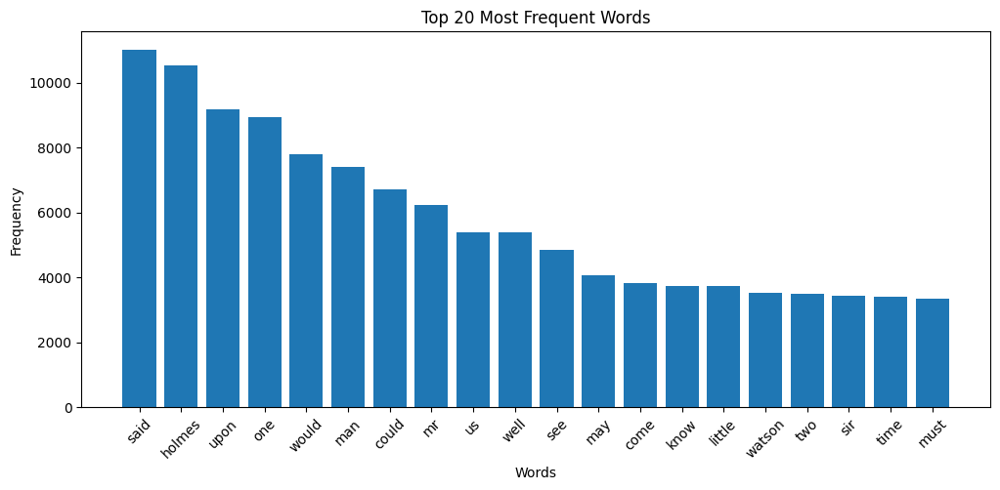

In [ ]:
from collections import Counter


# Flatten the list of lists into a single list
all_words = [word for story in stories_tokenized_nostopwords.values() for word in story]

# Count word frequency
word_counts = Counter(all_words)

common_words = word_counts.most_common(20)

# Show most common words
print(common_words)

words, counts = zip(*common_words)

# Plot histogram
plt.figure(figsize=(12, 5))
plt.bar(words, counts)
plt.xticks(rotation=45)
plt.xlabel("Words")
plt.ylabel("Frequency")
plt.title("Top 20 Most Frequent Words")
plt.show()



## Sentence Segmentation and Word Tokenization Handling Punctuation TAGGING

In [ ]:
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger_eng')
nltk.download('stopwords')


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger_eng.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk import pos_tag
from nltk.corpus import stopwords

# Define the set of stopwords
stop_words = set(stopwords.words('english'))

# Function to remove stopwords from a list of tokens
def remove_stopwords(tokens):
    return [word for word in tokens if word.lower() not in stop_words]

stories_tagged = {}
# Iterate through the stories dictionary
for i in stories:

    sentences = sent_tokenize(processed_stories_wspecialchar[i])
    # Step 3: Tokenization and POS tagging
    tokenized_and_tagged = []
    for sentence in sentences:
        # Tokenize the sentence
        tokens = word_tokenize(sentence)

        #stop word removal
        #remove_stop = remove_stopwords(tokens)
        # POS tagging for the tokens
        tagged_tokens = pos_tag(tokens)
        # Append tagged tokens to the result
        tokenized_and_tagged.extend(tagged_tokens)

    # Step 4: Overwrite the story with the tagged tokens
    stories_tagged[i] = tokenized_and_tagged

# Checking a story
print(stories_tagged[11])


[('THE', 'DT'), ('ILLUSTRIOUS', 'NNP'), ('CLIENT', 'NNP'), ('``', '``'), ('It', 'PRP'), ('ca', 'MD'), ("n't", 'RB'), ('hurt', 'VB'), ('now', 'RB'), (',', ','), ("''", "''"), ('was', 'VBD'), ('Mr.', 'NNP'), ('Sherlock', 'NNP'), ('Holmes', 'NNP'), ("'s", 'POS'), ('comment', 'NN'), ('when', 'WRB'), (',', ','), ('for', 'IN'), ('the', 'DT'), ('tenth', 'JJ'), ('time', 'NN'), ('in', 'IN'), ('as', 'RB'), ('many', 'JJ'), ('years', 'NNS'), (',', ','), ('I', 'PRP'), ('asked', 'VBD'), ('his', 'PRP$'), ('leave', 'NN'), ('to', 'TO'), ('reveal', 'VB'), ('the', 'DT'), ('following', 'JJ'), ('narrative', 'NN'), ('.', '.'), ('So', 'IN'), ('it', 'PRP'), ('was', 'VBD'), ('that', 'IN'), ('at', 'IN'), ('last', 'JJ'), ('I', 'PRP'), ('obtained', 'VBD'), ('permission', 'NN'), ('to', 'TO'), ('put', 'VB'), ('on', 'IN'), ('record', 'NN'), ('what', 'WP'), ('was', 'VBD'), (',', ','), ('in', 'IN'), ('some', 'DT'), ('ways', 'NNS'), (',', ','), ('the', 'DT'), ('supreme', 'JJ'), ('moment', 'NN'), ('of', 'IN'), ('my', 'P

# Task 2

Implement a Seq2Seq model using an Encoder-Decoder LSTM architecture for summarizing entire Sherlock Holmes stories into short summaries.
- Train the model to produce summaries of around 50-100 words.  
- Evaluate the model on both using suitable score metrics based on your research.

## Story Summarization

https://www.topcoder.com/thrive/articles/text-summarization-in-nlp

###Bad Summary

In [ ]:
import nltk
nltk.download('punkt_tab')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

In [ ]:
'''import nltk
from nltk.tokenize import sent_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer

nltk.download("punkt")  # Ensure necessary NLTK resources are available

def rank_sentences(text):
    sentences = sent_tokenize(text)  # Split text into sentences
    vectorizer = TfidfVectorizer(stop_words="english")

    # Ensure text has valid sentences before applying TF-IDF
    if not sentences:
        return []

    tfidf_matrix = vectorizer.fit_transform(sentences)

    # Calculate scores for each sentence (sum of the TF-IDF scores of the words)
    sentence_scores = []
    for i, sentence in enumerate(sentences):
        score = tfidf_matrix[i].sum()
        sentence_scores.append((score, sentence))

    # Sort sentences based on their scores in descending order
    ranked_sentences = sorted(sentence_scores, key=lambda x: x[0], reverse=True)
    return ranked_sentences

# Apply the ranking function to dictionary `processed_stories_wspecialchar`
stories = processed_stories_wspecialchar

# Function to summarize text using extractive summarization
def summarize_with_tfidf(story_text, num_sentences=5):
    # Ensure story_text is a valid string
    if not isinstance(story_text, str) or story_text.strip() == "":
        return ""

    # Rank sentences based on their importance
    ranked_sentences = rank_sentences(story_text)

    # Ensure there are enough sentences to summarize
    if len(ranked_sentences) < num_sentences:
        num_sentences = len(ranked_sentences)

    # Select the top 'num_sentences' sentences to form the summary
    summary_sentences = [sentence for _, sentence in ranked_sentences[:num_sentences]]

    # Combine the sentences to form the summary
    summary = " ".join(summary_sentences)

    return summary

# Apply summarization to each story
bad_summaries = {}
for story_id, story_text in stories.items():
    bad_summaries[story_id] = summarize_with_tfidf(story_text)

# Display summaries
for story_id, summary in bad_summaries.items():
    print(f"Summary of Story {story_id}:")
    print(summary)
    print("\n")
'''

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


Summary of Story 0:
it began in
     the middle of a sentence and ran like this:

     "... face bled considerably from the cuts and blows, but it was
     nothing to the bleeding of his heart as he saw that lovely face, the
     face for which he had been prepared to sacrifice his very life,
     looking out at his agony and humiliation. this strange, languid creature spent
     his waking hours in the bow window of a st. james's street club and
     was the receiving-station as well as the transmitter for all the
     gossip of the metropolis. it was quite evident that the three gables was under very close
     surveillance, for as we came round the high hedge at the end of the
     lane there was the negro prize-fighter standing in the shadow. she rose from a settee as we entered: tall, queenly, a
     perfect figure, a lovely mask-like face, with two wonderful spanish
     eyes which looked murder at us both. a minute later we were in an arabian
     nights drawing-room, vast and w

### Manual Summaries

In [ ]:
manual_stories_summary = {
    0: "A woman seeks Holmes' help when a mysterious buyer wants to purchase her house along with all its contents. Holmes uncovers a plot involving a love affair and a manuscript meant to defame a deceased lover. The mystery resolves with justice served.",
    1: "Holmes assists a man named Garrideb, who seeks namesakes to inherit a fortune. The case leads to the exposure of a conman with criminal motives. Holmes's sharp wit ensures the rightful outcome.",
    2: "Holmes is called to solve a cheating scandal at a university. Through meticulous observation, he identifies the culprit and safeguards academic integrity without public disgrace.",
    3: "Holmes investigates a baronet's murder at Abbey Grange. Although it appears to be a robbery, Holmes discovers a love triangle and a wronged lover seeking revenge, leading to a morally complex resolution.",
    5: "A banker brings Holmes a shattered coronet, claiming his son stole jewels. Holmes reveals that the true culprit is the banker’s niece's lover, restoring the family's honor.",
    6: "A sailor is found brutally murdered with a harpoon. Holmes navigates maritime intrigues to expose the killer, who acted in self-defense to thwart Black Peter’s dark past.",
    7: "Narrated by Holmes, a soldier seeks help finding his missing comrade. The case reveals a secret love affair and a leprosy misdiagnosis, clearing misunderstandings and reuniting families.",
    8: "Holmes investigates a lost Christmas goose that hides a stolen gem. With clever deductions, he uncovers the thief and returns the gem without ruining lives.",
    9: "A man is accused of patricide, but Holmes unravels evidence pointing to a family friend as the killer, driven by jealousy. Justice is served, exonerating the accused.",
    10: "Holmes is enlisted to recover stolen submarine plans linked to espionage. Using sharp tactics, he exposes betrayal within a family and secures national security.",
    21: "Dr. Watson is summoned to Baker Street, where he finds Sherlock Holmes gravely ill, apparently dying from a rare tropical disease. Holmes refuses medical help, only allowing Watson to bring Mr. Culverton Smith, a man Holmes suspects of murder. When Smith arrives, Holmes tricks him into confessing that he deliberately infected Holmes. The police, hiding nearby, arrest Smith. Holmes reveals that his illness was a ruse to trap the criminal, demonstrating his brilliant deception skills.",
    25: "Dr. Watson recounts a mysterious case involving John Openshaw, whose family is terrorized by the arrival of envelopes containing five orange pips and cryptic warnings. Holmes investigates the connection to the Ku Klux Klan, discovering Openshaw's father and uncle were involved with the group. Before Openshaw can be protected, he is found dead. Holmes identifies the senders aboard a ship and sends them a message with five orange pips, but they perish in a storm. The case remains unresolved, highlighting Holmes's frustration with justice denied by untimely fate.",
    28: "Sherlock Holmes and Dr. Watson meet Mycroft Holmes, Sherlock’s brilliant but indolent older brother. Mycroft introduces them to Mr. Melas, a Greek interpreter who was kidnapped and forced to translate for a captive man, Kratides. Holmes investigates and discovers that Kratides was being coerced into signing over his property. Despite Holmes' efforts, Kratides is murdered, and the criminals escape justice. The story highlights Mycroft’s intelligence and showcases Holmes' deductive prowess.",
    39: "Sherlock Holmes investigates an ancient family riddle, The Musgrave Ritual, brought to him by Reginald Musgrave. The ritual, a cryptic verse, leads Holmes to uncover hidden treasures beneath the Musgrave estate, including the crown jewels of a deposed monarch. The mystery deepens with the disappearance of Musgrave’s butler, Brunton, who attempted to steal the treasure but perished underground. Holmes solves the puzzle, demonstrating the interplay of intellect and historical intrigue, while Reginald gains closure on the enigmatic family tradition.",
    61: "Sherlock Holmes investigates the murder of Maria Gibson, shot on Thor Bridge, with her husband's governess, Grace Dunbar, accused due to circumstantial evidence. Holmes examines the crime scene and a curious clue—a fragment of a missing revolver. He deduces that Neil Gibson, Maria’s husband, staged the scene to implicate Grace after his wife’s suicide. Holmes uncovers Maria's jealousy and despair, proving Grace’s innocence. The case highlights Holmes’s brilliance in discerning human motives and piecing together overlooked evidence to reveal the truth.",
    41: "Lord St. Simon seeks Sherlock Holmes' help after his American bride, Hatty Doran, vanishes on their wedding day. Holmes investigates and uncovers that Hatty’s former husband, long presumed dead, is alive. She reunited with him after recognizing him at the wedding. Holmes solves the case effortlessly, revealing that Hatty had never intended to deceive St. Simon. The story showcases Holmes' deductive brilliance and his ability to unravel mysteries that baffle others.",
    42: "Sherlock Holmes is called upon when young lawyer John Hector McFarlane is accused of murdering Jonas Oldacre, a wealthy builder. The evidence, including a blood-stained walking stick and Oldacre’s will favoring McFarlane, seems damning. Holmes, however, uncovers a clever ruse: Oldacre faked his death to frame McFarlane and evade debts. Holmes finds Oldacre hiding in a concealed compartment on his property. The case highlights Holmes’s ability to see through deception and vindicate the wrongly accused through keen observation and logical deduction.",
    57: "Helen Stoner seeks Sherlock Holmes' help, fearing for her life after her twin sister Julia's mysterious death. Julia’s last words mentioned a speckled band. Holmes and Watson investigate Helen’s home, where her stepfather, Dr. Grimesby Roylott, keeps exotic animals. They discover he planned to kill Helen using a venomous swamp adder. Holmes stops the plot, and the snake fatally bites Roylott instead. The case showcases Holmes' keen deduction and quick thinking.",
    66: "Sherlock Holmes is approached by Grant Munro, who suspects his wife of hiding a secret in a neighboring cottage. Holmes investigates and discovers that she has been concealing her biracial daughter from a previous marriage, fearing society's prejudice and her husband's reaction. In a rare instance, Holmes' initial deductions are incorrect. However, Munro, upon learning the truth, reacts with love and acceptance. The story stands out for its compassionate message on race and prejudice in Victorian society."
}


In [ ]:
# Filter and match available stories with their summaries
common_stories_summaries = set(processed_stories_wspecialchar.keys()).intersection(set(manual_stories_summary.keys()))

# Extract matched stories and summaries
matched_stories = [processed_stories_wspecialchar[key] for key in common_stories_summaries]
matched_summaries = [manual_stories_summary[key] for key in common_stories_summaries]

In [ ]:
matched_summaries[11] # number 11 is story 25

"Dr. Watson recounts a mysterious case involving John Openshaw, whose family is terrorized by the arrival of envelopes containing five orange pips and cryptic warnings. Holmes investigates the connection to the Ku Klux Klan, discovering Openshaw's father and uncle were involved with the group. Before Openshaw can be protected, he is found dead. Holmes identifies the senders aboard a ship and sends them a message with five orange pips, but they perish in a storm. The case remains unresolved, highlighting Holmes's frustration with justice denied by untimely fate."

## Seq2Seq Model

Take bad_summaries and apply seq2seq model using an Encoder-Decoder LSTM architecture ???

**What is a Seq2Seq Model?**
- A seq2seq model aims to map a fixed length input with a fixed length output even when their length differs.
- As an example translating the English phrase "Good Afternoon" to the Greek phrase "Καλησπέρα".
- In our case, the entire story and the summary have different length as the one is significally shorter than the other.

**What is Encoder-Decoder LSTM?**
- A recurrent neural network designed to address sequence-to-sequence problems, that has proven very effective.
- This architecture is comprised of two models:
    - one for reading the input sequence and encoding it into a fixed-length vector
    - a second for decoding the fixed-length vector and outputting the predicted sequence.
- The use of the models in concert gives the architecture its name of Encoder-Decoder LSTM designed specifically for seq2seq problems.

---

https://machinelearningmastery.com/encoder-decoder-long-short-term-memory-networks/

https://towardsdatascience.com/understanding-encoder-decoder-sequence-to-sequence-model-679e04af4346

https://www.geeksforgeeks.org/seq2seq-model-in-machine-learning/



---

A seq2seq model is going to be used in this case to create abtract summarisation of the stories.

> It is possible to use a seq2seq model to create abstract summaries via reinforcement learning which would be great in this case because of the small dataset and how we don't already have summaries...would that be possible with encoder decoder solution?

### Vectorisation





Tokenize and prepare the sequences for the model.


In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np


# Add special tokens to summaries
matched_summaries = [f"<start> {summary} <end>" for summary in matched_summaries]

# Initialize the tokenizer
tokenizer = Tokenizer(oov_token="<OOV>") #handle out-of-vocabulary words, replacing unknown words with <OOV>.

# Combine all stories and summaries for fitting the tokenizer
all_text = matched_stories + matched_summaries
tokenizer.fit_on_texts(all_text)

# Vocabulary size
vocab_size = len(tokenizer.word_index) + 1

encoder_input_seqs = [tokenizer.texts_to_sequences([story])[0] for story in matched_stories]
decoder_input_seqs = [tokenizer.texts_to_sequences([summary])[0] for summary in matched_summaries]

# Find maximum lengths for padding
max_encoder_seq_length = max(len(seq) for seq in encoder_input_seqs) # Finds the longest input story
#max_decoder_seq_length = max(len(seq) for seq in decoder_input_seqs)
max_decoder_seq_length = 100  # Fixed max length for summaries


# Pad all sequences to ensure uniform length
# pad_sequences() adds zeros to shorter sequences to match the maximum length.
#padding="post" means padding is added at the end, not the beginning.

encoder_input_padded = pad_sequences(encoder_input_seqs, maxlen=max_encoder_seq_length, padding="post")
decoder_input_padded = pad_sequences(decoder_input_seqs, maxlen=max_decoder_seq_length, padding="post")




In [ ]:
#Create decoder target sequences by shifting
decoder_target_padded = np.zeros_like(decoder_input_padded)
decoder_target_padded[:, :-1] = decoder_input_padded[:, 1:]

'''This step shifts the decoder input sequences by one position to the left to create decoder target sequences.
Seq2Seq models use teacher forcing, where the decoder is trained to predict the next word in the sequence.

The decoder input (decoder_input_padded) starts with the <start> token.
The decoder target (decoder_target_padded) is the same as decoder_input_padded but shifted left by one step.
The model is trained to predict the next word at each time step.'''

'This step shifts the decoder input sequences by one position to the left to create decoder target sequences.\nSeq2Seq models use teacher forcing, where the decoder is trained to predict the next word in the sequence.\n\nThe decoder input (decoder_input_padded) starts with the <start> token.\nThe decoder target (decoder_target_padded) is the same as decoder_input_padded but shifted left by one step.\nThe model is trained to predict the next word at each time step.'

> It can be noticed that special tokens were added to the summaries. Seq2Seq models generate text step by step; adding <start> and <end> tokens helps the model know when to begin and stop generating text.
This is similar to how transformers (e.g., BERT, GPT) use special tokens.
The <start> token helps the decoder initialize and predict the first word.
The <end> token signals the model to stop generation, preventing it from generating unnecessary words.

### Build the Encoder-Decoder Model


**Encoder:** The encoder processes the input sequence and encodes it into a context vector.


In [ ]:
'''from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Embedding, LSTM, Dense

embedding_dim = 256
latent_dim = 512
# Encoder
encoder_inputs = Input(shape=(max_encoder_seq_length,))
encoder_embedding = Embedding(input_dim=vocab_size, output_dim=embedding_dim)(encoder_inputs)
encoder_lstm = LSTM(latent_dim, return_sequences=True, return_state=True)
encoder_outputs, state_h, state_c = encoder_lstm(encoder_embedding)

# Save encoder states
encoder_states = [state_h, state_c]

'''

**Decoder:** For inference, the decoder uses the encoder's context vectors as the initial states and generates one word at a time:



In [ ]:
'''# Decoder
decoder_inputs = Input(shape=(max_decoder_seq_length,))
decoder_embedding = Embedding(input_dim=vocab_size, output_dim=embedding_dim)(decoder_inputs)
decoder_lstm = LSTM(latent_dim, return_sequences=True, return_state=True)
decoder_outputs, _, _ = decoder_lstm(decoder_embedding, initial_state=encoder_states)

# Fully connected layer for prediction
decoder_dense = Dense(vocab_size, activation="softmax")
decoder_outputs = decoder_dense(decoder_outputs)

'''

### Build the Encoder-Decoder Model with attention


Attention solves a problem in traditional Seq2Seq models where the decoder must rely on the final encoder state. This loses important information from earlier parts of long sequences. The attention mechanism allows the model to focus on different parts of the input sequence at each step of the output generation.

- Attention allows the decoder to focus on specific words at each step.
- Improves performance on long text summaries.
- Helps generate more meaningful summaries.

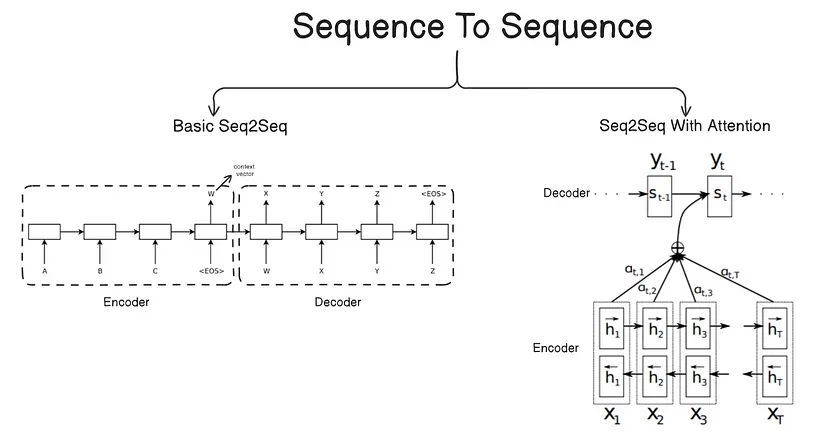

https://medium.com/@fraidoonomarzai99/seq2seq-encoder-decoder-and-attention-mechanism-in-depth-417ef88037f1

In [ ]:
from tensorflow.keras.layers import Input, LSTM, Dense, Embedding, Concatenate
from tensorflow.keras.layers import AdditiveAttention as Attention
from tensorflow.keras.models import Model

# Model parameters
embedding_dim = 256
latent_dim = 512


# Encoder
encoder_inputs = Input(shape=(max_encoder_seq_length,))
encoder_embedding = Embedding(input_dim=vocab_size, output_dim=embedding_dim)(encoder_inputs)
encoder_lstm = LSTM(latent_dim, return_state=True)
encoder_outputs, state_h, state_c = encoder_lstm(encoder_embedding)

# Save encoder states
encoder_states = [state_h, state_c]

# Decoder
decoder_inputs = Input(shape=(max_decoder_seq_length,))
decoder_embedding = Embedding(input_dim=vocab_size, output_dim=embedding_dim)(decoder_inputs)
decoder_lstm = LSTM(latent_dim, return_sequences=True, return_state=True)
decoder_outputs, _, _ = decoder_lstm(decoder_embedding, initial_state=encoder_states)

# Attention Layer
attention = Attention()
attention_output = attention([decoder_outputs, encoder_outputs])

# Concatenating attention output and decoder LSTM output
decoder_concat_input = Concatenate(axis=-1)([decoder_outputs, attention_output])

# Fully connected layer for prediction
decoder_dense = Dense(vocab_size, activation="softmax")
decoder_outputs = decoder_dense(decoder_concat_input)  # Apply Dense layer to concatenated input




### Create the Model:



In [ ]:
from tensorflow.keras.models import Model

model= Model([encoder_inputs,decoder_inputs],decoder_outputs)
model.compile(optimizer="adam",loss="sparse_categorical_crossentropy", metrics=['accuracy'])

In [ ]:
'''from tensorflow.keras.optimizers import Adam

optimizer = Adam(learning_rate=0.0001)  # Reduce learning rate
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
'''

In [ ]:
# Summary
model.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5             │ (None, 10771)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ input_layer_6             │ (None, 90)             │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ embedding_3 (Embedding)   │ (None, 10771, 64)      │        551,232 │ input_layer_5[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ embedding_4 (Embedding)   │ (None, 90, 256)        │      2,204,928 │ input_layer_6[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_2 (LSTM)             │ [(None, 10771, 64),    │         33,024 │ embedding_3[0][0]      │
│                           │ (None, 64), (None,     │                │                        │
│                           │ 64)]                   │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lstm_3 (LSTM)             │ [(None, 90, 512),      │      1,574,912 │ embedding_4[0][0],     │
│                           │ (None, 512), (None,    │                │ lstm_2[0][1],          │
│                           │ 512)]                  │                │ lstm_2[0][2]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 90, 8613)       │      4,418,469 │ lstm_3[0][0]           │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 8,782,565 (33.50 MB)

 Trainable params: 8,782,565 (33.50 MB)

 Non-trainable params: 0 (0.00 B)

### Train the Model


In [ ]:
print("Encoder Input Shape:", encoder_input_padded.shape)
print("Decoder Input Shape:", decoder_input_padded.shape)
print("Decoder Target Shape:", decoder_target_padded.shape)


Encoder Input Shape: (19, 10771)
Decoder Input Shape: (19, 100)
Decoder Target Shape: (19, 100)


In [ ]:

from tensorflow.keras.callbacks import EarlyStopping

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model.fit(
    [encoder_input_padded, decoder_input_padded],
    np.expand_dims(decoder_target_padded, axis=-1),  # Expand target dimensions
    batch_size=32,
    epochs=100,
    callbacks=[early_stopping])




Epoch 1/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.9832 - loss: 0.2403
Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - accuracy: 0.9832 - loss: 0.2388
Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9832 - loss: 0.2374
Epoch 4/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9832 - loss: 0.2359
Epoch 5/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9832 - loss: 0.2345
Epoch 6/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.9837 - loss: 0.2331
Epoch 7/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.9842 - loss: 0.2317
Epoch 8/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9842 - loss: 0.2303
Epoch 9/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9842 - loss: 0.2289
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9842 - loss: 0.2275
Epoch 11/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.9842 - loss: 0.2262
Epoch 12/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - accuracy: 0.9842 - loss: 0.2248
Epoch 13/100


In [ ]:
'''# 7. Train the Model
model.fit(
    [encoder_input_padded, decoder_input_padded],
    np.expand_dims(decoder_target_padded, axis=-1),  # Expand target dimensions
    batch_size=8,
    epochs=100,
)
'''

Epoch 1/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 797ms/step - accuracy: 0.5347 - loss: 2.1197
Epoch 2/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 802ms/step - accuracy: 0.5580 - loss: 2.0389
Epoch 3/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 807ms/step - accuracy: 0.5869 - loss: 1.8889
Epoch 4/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 814ms/step - accuracy: 0.5551 - loss: 2.0489
Epoch 5/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 812ms/step - accuracy: 0.5635 - loss: 1.9756
Epoch 6/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 809ms/step - accuracy: 0.6104 - loss: 1.7625
Epoch 7/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 827ms/step - accuracy: 0.5622 - loss: 1.9692
Epoch 8/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 821ms/step - accuracy: 0.5683 - loss: 1.9382
Epoch 9/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 822ms/step - accuracy: 0.5682 - loss: 1.9525
Epoch 10/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 836ms/step - accuracy: 0.5379 - loss: 2.0685
Epoch 11/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 832ms/step - accuracy: 0.5703 - loss: 1.8971
Epoch 12/100
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 830ms/step - accuracy:

The accuracy is not great but it's way better than when not using attention layer.

### Make Predictions (Inference)


Define the Inference Process
This function generates the output sequence step by step: The code is give to you in the cell below- have a look

In [ ]:
'''def decode_sequence(input_seq):
    # Encode the input sequence to get the context vectors
    states_value = encoder_model.predict(input_seq)

    # Initialize the target sequence with the start token
    target_seq = np.zeros((1, 1))
    target_seq[0, 0] = tokenizer.word_index["start"]

    # Placeholder for the decoded sentence
    decoded_sentence = ""

    # Loop for maximum sequence length
    for _ in range(max_decoder_seq_length):
        # Predict the next word
        output_tokens, h, c = decoder_model.predict([target_seq] + states_value)

        # Get the index of the most likely word
        sampled_token_index = np.argmax(output_tokens[0, -1, :])
        sampled_word = tokenizer.index_word.get(sampled_token_index, "")

        # Append the word to the decoded sentence
        decoded_sentence += " " + sampled_word

        # Exit if the end token is predicted
        if sampled_word == "end" or sampled_word == "":
            break

        # Update the target sequence with the sampled word
        target_seq[0, 0] = sampled_token_index

        # Update the states
        states_value = [h, c]

    return decoded_sentence
'''

when attention layer use instead:

In [ ]:
def decode_sequence(input_seq):
    state_h, state_c = encoder_model.predict(input_seq)

    encoder_context = state_h

    start_token_idx = tokenizer.word_index.get("start")
    end_token_idx = tokenizer.word_index.get("end")

    target_seq = np.array([[start_token_idx]])
    decoded_sentence = ""
    states = [state_h, state_c]

    for _ in range(max_decoder_seq_length):
        output_tokens, h, c = decoder_model.predict([target_seq, encoder_context] + states)
        sampled_token_index = np.argmax(output_tokens[0, -1, :])
        sampled_word = tokenizer.index_word.get(sampled_token_index, "")
        decoded_sentence += " " + sampled_word

        if sampled_token_index == end_token_idx or sampled_word == "":
            break

        target_seq = np.array([[sampled_token_index]])
        states = [h, c]

    return decoded_sentence


---

In [ ]:
'''#Set Up the Inference Models

# Encoder inference model
encoder_model = Model(encoder_inputs, encoder_states)

# Inputs for inference decoder
decoder_state_input_h = Input(shape=(latent_dim,))
decoder_state_input_c = Input(shape=(latent_dim,))
decoder_states_inputs = [decoder_state_input_h, decoder_state_input_c]

# Decoder embedding
decoder_inputs_single = Input(shape=(1,))  # Decoder only processes one word at a time
decoder_embedding_inf = Embedding(input_dim=vocab_size, output_dim=embedding_dim)(decoder_inputs_single)

# LSTM for inference
decoder_lstm_inf = LSTM(latent_dim, return_sequences=True, return_state=True)
decoder_outputs_inf, state_h_inf, state_c_inf = decoder_lstm_inf(
    decoder_embedding_inf, initial_state=decoder_states_inputs
)
decoder_states_inf = [state_h_inf, state_c_inf]

# Dense layer for predictions
decoder_outputs_inf = decoder_dense(decoder_outputs_inf)

# Decoder inference model
decoder_model = Model(
    [decoder_inputs_single] + decoder_states_inputs,
    [decoder_outputs_inf] + decoder_states_inf
)
'''

when attention layer use instead:

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, LSTM, Dense, Embedding, Concatenate,Lambda
from tensorflow.keras.layers import AdditiveAttention as Attention
from tensorflow.keras.models import Model


encoder_model = Model(encoder_inputs, encoder_states)

encoder_outputs_inf = Input(shape=(latent_dim,), name="encoder_outputs_inf")

# Inference decoder state inputs
decoder_state_input_h = Input(shape=(latent_dim,), name="decoder_state_input_h")
decoder_state_input_c = Input(shape=(latent_dim,), name="decoder_state_input_c")
decoder_states_inputs = [decoder_state_input_h, decoder_state_input_c]

# Single token decoder input
decoder_inputs_single = Input(shape=(1,), name="decoder_inputs_single")
decoder_embedding_layer = Embedding(input_dim=vocab_size, output_dim=embedding_dim)

# Use the same embedding layer (make sure you kept a reference to it)
decoder_embedding_inf = decoder_embedding_layer(decoder_inputs_single)  # Changed line

# Run the decoder LSTM for one time step
decoder_outputs_inf, state_h_inf, state_c_inf = decoder_lstm(
    decoder_embedding_inf, initial_state=decoder_states_inputs
)
decoder_states_inf = [state_h_inf, state_c_inf]

# Expand the encoder outputs to have a time axis (from shape (None, latent_dim) to (None, 1, latent_dim))
encoder_outputs_inf_expanded = Lambda(lambda x: tf.expand_dims(x, axis=1))(encoder_outputs_inf)

# Compute attention: queries=decoder output, keys/values=encoder outputs
attention_output_inf = attention([decoder_outputs_inf, encoder_outputs_inf_expanded])
# Concatenate the decoder LSTM output and attention output
decoder_concat_inf = Concatenate(axis=-1)([decoder_outputs_inf, attention_output_inf])
# Apply the Dense layer
decoder_outputs_inf = decoder_dense(decoder_concat_inf)

# Define the inference decoder model.
decoder_model = Model(
    [decoder_inputs_single, encoder_outputs_inf] + decoder_states_inputs,
    [decoder_outputs_inf] + decoder_states_inf
)


### Test the Model with Input Text


Provide the input text for prediction:

In [ ]:
max_encoder_seq_length = max(len(seq) for seq in encoder_input_seqs)
max_decoder_seq_length

100

In [ ]:
# Iterate through each story and generate summaries
for i, text in enumerate(matched_stories):
    # Prepare the input sequence (pad and tokenize)
    input_seq = pad_sequences(
        tokenizer.texts_to_sequences([text]), maxlen=max_encoder_seq_length, padding="post"
    )

    # Decode the sequence to generate the summary
    predicted_summary = decode_sequence(input_seq)
    #print(f"Story {i+1}: {text}")
    print(f"Predicted Summary {i+1}: {predicted_summary}")
    print("-" * 50)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━

KeyboardInterrupt: 

# Task 3

- Create vector embeddings for individual paragraphs from the Sherlock Holmes dataset using pre-trained models like all-MiniLM-L6-v2.
- Store these embeddings in ChromaDB.
- Implement a semantic search system where users can query sentences or phrases,and the system retrieves semantically similar paragraphs.

##Split text into paragraphs

- First step to create vector embeddings for individual paragraphs is to split the paragraphs.
- The problem that arises if we try to simply split the paragraphs by empty lines is that many documents include dialogue which is part of the previous paragraph and also some text that is too small to be one paragraph.
- An optimal way hasn't been found but for now if a text chunk is less than 2 lines then it's joined with the previous paragraph and also if it starts and ends with quotes (dialogue) then it's merged with the previous paragraph as well.


In [ ]:
import re

def classify_and_merge_paragraphs(processed_stories_wspecialchar):

    all_paragraphs = {}

    for story_id, story_text in processed_stories_wspecialchar.items():
        paragraphs = []
        # Split the story into chunks based on blank lines
        chunks = story_text.split("\n\n")
        current_paragraph = ""

        for chunk in chunks:
            chunk = chunk.strip()
            if not chunk:
                continue

            # Rule 1: Join paragraphs less than two lines with the previous one
            if len(chunk.splitlines()) < 2:
                if current_paragraph:
                    current_paragraph += " " + chunk
                else:
                    current_paragraph = chunk
                continue

            # Rule 2: Join paragraphs starting and ending with quotation marks
            if chunk.startswith('"') and chunk.endswith('"'):
                if current_paragraph:
                    current_paragraph += " " + chunk
                else:
                    current_paragraph = chunk
                continue

            # Otherwise, save the current paragraph and start a new one
            if current_paragraph:
                paragraphs.append(current_paragraph.strip())
            current_paragraph = chunk

        # Add any remaining paragraph
        if current_paragraph:
            paragraphs.append(current_paragraph.strip())

        # Save paragraphs for the story
        all_paragraphs[story_id] = paragraphs

    return all_paragraphs


# Process the stories
paragraphs = classify_and_merge_paragraphs(processed_stories_wspecialchar)

# Function to retrieve a specific paragraph
def get_paragraph(story_id, paragraph_index):
    if story_id not in paragraphs:
        return f"Story ID {story_id} not found."
    if paragraph_index < 1 or paragraph_index > len(paragraphs[story_id]):
        return f"Paragraph {paragraph_index} not found in Story ID {story_id}."
    return paragraphs[story_id][paragraph_index - 1]


# Query example
story_id_to_query = 0
paragraph_index_to_query = 2
result = get_paragraph(story_id_to_query, paragraph_index_to_query)
print(f"\nStory {story_id_to_query}, Paragraph {paragraph_index_to_query}: {result}")



Story 0, Paragraph 2: the door had flown open and a huge negro had burst into the room. he
     would have been a comic figure if he had not been terrific, for he
     was dressed in a very loud gray check suit with a flowing
     salmon-coloured tie. his broad face and flattened nose were thrust
     forward, as his sullen dark eyes, with a smouldering gleam of malice
     in them, turned from one of us to the other. "which of you gen'l'men is masser holmes?" he asked. holmes raised his pipe with a languid smile. "oh! it's you, is it?" said our visitor, coming with an unpleasant,
     stealthy step round the angle of the table. "see here, masser holmes,
     you keep your hands out of other folks' business. leave folks to
     manage their own affairs. got that, masser holmes?" "keep on talking," said holmes. "it's fine." "oh! it's fine, is it?" growled the savage. "it won't be so damn fine
     if i have to trim you up a bit. i've handled your kind before now,
     and they didn't l

In [ ]:
story_id_to_output = 2

if story_id_to_output in paragraphs:
    print(f"\nStory ID: {story_id_to_output}")
    for i, para in enumerate(paragraphs[story_id_to_output], 1):
        print(f"Paragraph {i}: {para}")
else:
    print(f"Story ID {story_id_to_output} not found.")



Story ID: 2
Paragraph 1: it was in the year '95 that a combination of events, into which i
     need not enter, caused mr. sherlock holmes and myself to spend some
     weeks in one of our great university towns, and it was during this
     time that the small but instructive adventure which i am about to
     relate befell us. it will be obvious that any details which would
     help the reader to exactly identify the college or the criminal would
     be injudicious and offensive. so painful a scandal may well be
     allowed to die out. with due discretion the incident itself may,
     however, be described, since it serves to illustrate some of those
     qualities for which my friend was remarkable. i will endeavour in my
     statement to avoid such terms as would serve to limit the events to
     any particular place, or give a clue as to the people concerned.
Paragraph 2: we were residing at the time in furnished lodgings close to a library
     where sherlock holmes was pursu

##Create vector embeddings

### theory

Vector embedding is a technique that transforms text into a numerical format that computers can understand. Think of it like giving each word a unique address in a high-dimensional space, where words with similar meanings have addresses that are closer together.

*   **Text to Numbers:**  Computers can't directly process words; they need numbers. Vector embedding converts words into numerical arrays (vectors). For example, the word "cat" might become \[0.2, -0.5, 0.8, ...], and the word "dog" might be \[0.3, -0.4, 0.7, ...]
*   **Capturing Meaning:** These numerical vectors aren't random; they're created in a way that captures the meaning of the word. Words with related meanings will have vectors that are close together in the vector space. So, "cat" and "dog" will have vectors that are closer than "cat" and "airplane."
*   **Vocabulary:** A vocabulary is created which contains all the unique words in the dataset.

Why is it used?
*   **Machine Learning Compatibility:**  Machine learning models require numerical data to work. Vector embeddings enable models to process text, which they can't do in its original text form.
*   **Semantic Understanding:** Because similar words have similar vectors, models can start to understand the relationships between words. This allows machines to grasp the context and meaning of text, which is crucial for tasks such as translation, text classification, and chatbots.
*   **Efficient Processing:**  Once text is converted to vectors, these vectors can be saved in a database. Vector databases are designed to efficiently store and retrieve vector embeddings. These databases can quickly search for similar vectors using similarity algorithms, allowing applications to find related text based on meaning.
*   **Pretrained Embeddings**: Because generating embeddings can be very computationally intensive, pre-trained embeddings are often used which provide a more efficient way to start using text embeddings.
*   **Language Models:** A language model is represented by a probability distribution over words in a vocabulary.
In short, vector embeddings are a fundamental tool in natural language processing, allowing computers to make sense of text by turning words into numbers that capture their meaning and relationships.


## Vector embedding using all-MiniLM-L6-v2

- First step to apply semantic search is vector embedding.
- The reason behind this is that vector embeddings convert text into embeddings that map them into a continuous, high-dimensional vector space. This enables efficient similarity calculations (e.g., cosine similarity), making it possible to find semantically similar passages even if they don’t share exact words.
- The pretrained model used for vector embedding is allMiniLM-L6-v2. The reason behind this choice is because it’s lightweight but also has a high accuracy while performing embedding tasks.
https://huggingface.co/sentence-transformers/all-MiniLM-L6-v2

---

Actually creating vector embeddings is not too complicated. You simply have to initialize the model and generate the embeddings for each paragraph.

In [ ]:
from sentence_transformers import SentenceTransformer

# Initialize the SentenceTransformer model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Generate embeddings for each paragraph
story_embeddings = {}

for story_id, paragraphs_list in paragraphs.items():
    embeddings = model.encode(paragraphs_list)  # Generate embeddings for all paragraphs of the story
    story_embeddings[story_id] = embeddings

#------

# Output embeddings for each story
for story_id, embeddings in story_embeddings.items():
    print(f"\nStory ID: {story_id}")
    for i, embedding in enumerate(embeddings, 1):
        print(f"Paragraph {i} Embedding (first 5 values): {embedding[:5]}...")  # Display only first 5 values




/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Streaming output truncated to the last 5000 lines.
Paragraph 24 Embedding (first 5 values): [0.00815497 0.09536275 0.0646676  0.01611828 0.03959879]...
Paragraph 25 Embedding (first 5 values): [-0.03482816  0.1125914   0.04997928  0.01480814  0.0796302 ]...
Paragraph 26 Embedding (first 5 values): [-0.08337163  0.14091025 -0.02389798  0.0095063   0.03077549]...
Paragraph 27 Embedding (first 5 values): [-0.01998422  0.03656216  0.04903087 -0.00192979  0.0374617 ]...
Paragraph 28 Embedding (first 5 values): [-0.10875921  0.13823983  0.03874291  0.00666329  0.08941806]...
Paragraph 29 Embedding (first 5 values): [-0.0506124   0.07355796  0.01220307  0.05834129  0.06084976]...
Paragraph 30 Embedding (first 5 values): [-0.02882946  0.09489436  0.09432722  0.00582568  0.02413955]...
Paragraph 31 Embedding (first 5 values): [-0.02516182  0.11614639  0.07858258  0.03573055  0.04212615]...
Paragraph 32 Embedding (first 5 values): [-0.10438798  0.06137409  0.04272282  0.02674722  0.08720363]...


##Store embeddings to ChromaDB

- After applying vector embedding we need a place to store these embeddings
- A traditional database wouldn’t be a good idea as they struggle with high-dimensional vector searches because indexing and query performance degrade as dimensions increase.
- ChromaDB on the other hand is specializedfor storing and retrieving high-dimensional vector data efficiently.
- It allows you to:
  - Store semantic embeddings of text, images, or other data types
  - Perform fast nearest-neighbor searches based on similarity.
  - Persist and reload stored embeddings for later use.

---

In [ ]:
pip install chromadb openai

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.3/67.3 kB 5.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.1/611.1 kB 22.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 67.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 278.6/278.6 kB 24.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 94.8/94.8 kB 10.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 92.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.6/101.6 kB 10.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 108.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.9/55.9 kB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 177.4/177.4 kB 19.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.0/65.0 kB 6.8 MB/s eta 

First step is to initialise the client

In [ ]:
import chromadb
from chromadb.config import Settings

client = chromadb.PersistentClient(path = "db")
print("ChromaDB client initialised successfully")

ChromaDB client initialised successfully


> *You may ask why to use (path = "db"). Well, it simply allows to store the database on disk and persist the embeddings between runs, in a few words it stores the database and doesn't run it only in memory. There's no specific reason why they are stored in this case it's just a preference as the dataset is not large.*

After initializing the client, we will create a collection object by using it. It is similar to creating a table in a traditional database.

In [ ]:
 #client.delete_collection(name="Stories")

ValueError: Collection Stories does not exist.

In [ ]:
collection = client.create_collection(name="Stories")


> *So far steps are not complicated you simply have to initialise stuff which is great*

---


- That's where things are getting a bit more complicated. We have to use the collection.add() function
- We need collection.add() because ChromaDB is a vector database, and it stores the text and embeddings together to  retrieve similar text later.
- The function adds text data into a ChromaDB collection along with:
  - Unique IDs (ids) → Identifiers for each entry.
  - Text Data (documents) → The actual text ( the paragraphs)
  - Metadata (metadatas) → Extra information like the source of the text.
  - Embeddings (embeddings) → The numerical vector representation of the text (used for semantic search).




- Another tricky thing is that chromadb automatically downloads the all-MiniLM-L6-v2 model to convert the text into embeddings.
- However, we have already performed embedding and that means that we have to specify that we don't need it to perform the embedding cuz we have already done it..here's the precomputed embedding
- It can be noticed that there's no specific reason to compute the embedding seperately as in both cases all-MiniLM-L6-v2 is used so it adds extra steps for no specific reason.
- However that makes it easier to use a different embedding in the future if the specific one doesn't perform well enough.

> *You can notice that the processing happens in batches...the reason behind this is simple...processing everything at once caused significant lag on the computer*

In [ ]:
'''from sentence_transformers import SentenceTransformer



# Define the batch size
BATCH_SIZE = 100

def add_documents_in_batches(grouped_stories, precomputed_embeddings, collection, batch_size=BATCH_SIZE):
    """
    Adds documents (paragraphs) to the collection in batches, using precomputed embeddings.

    Parameters:
    - grouped_stories: dict, where keys are story IDs and values are lists of paragraph strings.
    - precomputed_embeddings: dict with the same keys as grouped_stories; values are lists of embeddings.
    - collection: an object (e.g., a ChromaDB collection) that supports the add method.
    - batch_size: number of documents to process in each batch.
    """
    documents = []
    metadatas = []
    ids = []
    embeddings = []

    for story_id, paragraphs in grouped_stories.items():
        for idx, paragraph in enumerate(paragraphs):
            documents.append(paragraph)
            # Include both story ID and paragraph number in metadata
            metadatas.append({"source": story_id, "paragraph": idx + 1})
            unique_id = f"{story_id}_{idx}"  # Unique ID combining story ID and paragraph index
            ids.append(unique_id)

            # Use the precomputed embedding for this paragraph.
            embedding = precomputed_embeddings[story_id][idx]
            embeddings.append(embedding)

            # When the batch size is reached, add the batch to the collection.
            if len(documents) == batch_size:
                collection.add(
                    documents=documents,
                    metadatas=metadatas,
                    ids=ids,
                    embeddings=embeddings
                )
                print(f"Added batch of {batch_size} documents.")

                # Clear the lists for the next batch.
                documents, metadatas, ids, embeddings = [], [], [], []

    # Add any remaining documents
    if documents:
        collection.add(
            documents=documents,
            metadatas=metadatas,
            ids=ids,
            embeddings=embeddings
        )
        print(f"Added final batch of {len(documents)} documents.")

add_documents_in_batches(paragraphs, story_embeddings, collection, batch_size=BATCH_SIZE)
'''

Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batc

- The reason the approach above is not followed anymore but the function nowstores all paragraphs, embeddings, and metadata globally in all_documents, all_embeddings, and all_metadatas as presented below is to enable manual search queries using multiple similarity metrics (Euclidean distance, dot product, etc.) and not just cosine similarity which is the default.
- This will allow us to see if changing the similarity metric makes any difference.

In [ ]:
from sentence_transformers import SentenceTransformer

# Define the batch size
BATCH_SIZE = 100

def add_documents_in_batches(grouped_stories, precomputed_embeddings, collection, batch_size=BATCH_SIZE):
    """
    Adds documents (paragraphs) to the collection in batches, using precomputed embeddings.
    Returns a tuple (all_documents, all_embeddings, all_metadatas) containing all paragraphs, embeddings, and metadata.
    """
    all_documents = []  # To store every paragraph globally
    all_embeddings = []  # To store every embedding globally
    all_metadatas = []  # To store metadata globally

    documents = []
    metadatas = []
    ids = []
    embeddings = []

    for story_id, paragraphs in grouped_stories.items():
        for idx, paragraph in enumerate(paragraphs):
            documents.append(paragraph)
            all_documents.append(paragraph)  # Save globally

            # Create metadata for this paragraph
            metadata_entry = {"source": story_id, "paragraph": idx + 1}
            metadatas.append(metadata_entry)
            all_metadatas.append(metadata_entry)
            unique_id = f"{story_id}_{idx}"
            ids.append(unique_id)

            # Use the precomputed embedding for this paragraph
            embedding = precomputed_embeddings[story_id][idx]
            embeddings.append(embedding)
            all_embeddings.append(embedding)  # Save globally

            # When the batch size is reached, add the batch to the collection.
            if len(documents) == batch_size:
                collection.add(
                    documents=documents,
                    metadatas=metadatas,
                    ids=ids,
                    embeddings=embeddings
                )
                print(f"Added batch of {batch_size} documents.")

                # Clear the lists for the next batch
                documents, metadatas, ids, embeddings = [], [], [], []

    # Add any remaining documents
    if documents:
        collection.add(
            documents=documents,
            metadatas=metadatas,
            ids=ids,
            embeddings=embeddings
        )
        print(f"Added final batch of {len(documents)} documents.")

    return all_documents, all_embeddings, all_metadatas


all_documents, all_embeddings, all_metadatas = add_documents_in_batches(paragraphs, story_embeddings, collection, batch_size=BATCH_SIZE)


Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batch of 100 documents.
Added batc

## Perform similarity search

*Great news! We've successfully stored the IDs, documents, metadata, and embeddings together. Now, we're ready to perform a similarity search!*

To run a similarity search, the easiest way is by using the **query()** function to ask questions in natural language. It will convert the query into embedding and use similarity algorithms to generate similar results. In our case, it is returning x similar results.


> It is worth noticing that this performs a prebuilt similarity check...this can be further customised by choosing how to calculate the distance between vectors by ourselves but we will be using this prebuilt way first to have an idea of the results. Let alone that chromadb by default uses cosine similarity for comparing vectors which is a pretty good way and moreover encoding is happening by all-MiniLM-L6-v2 which is the one we are using for encoding the paragraphs so no need to change it (even tho if we used a different method we would have to).

https://docs.trychroma.com/docs/querying-collections/query-and-get

In [ ]:
# Perform similarity query
results = collection.query(
    query_texts=["Find paragraphs where Sherlock is solving a case."],
    n_results=7  # Number of top similar results
)

results

/root/.cache/chroma/onnx_models/all-MiniLM-L6-v2/onnx.tar.gz: 100%|██████████| 79.3M/79.3M [00:02<00:00, 36.6MiB/s]


{'ids': [['13_239', '11_4067', '60_37', '4_154', '9_2', '11_770', '15_770']],
 'embeddings': None,
 'documents': [['i have only one further note of this case. it is the letter which\n     holmes wrote in final answer to that with which the narrative begins.\n     it ran thus:',
   'i have only one further note of this case. it is the letter which\n     holmes wrote in final answer to that with which the narrative begins.\n     it ran thus:',
   'i have only one further note of this case. it is the letter which\n     holmes wrote in final answer to that with which the narrative begins.\n     it ran thus:',
   'we had the carriage to ourselves save for an immense litter of papers\n     which holmes had brought with him. among these he rummaged and read,\n     with intervals of note-taking and of meditation, until we were past\n     reading. then he suddenly rolled them all into a gigantic ball and\n     tossed them up onto the rack. "have you heard anything of the case?" he asked. "not a

Present it a bit better:

In [ ]:
def display_search_results(results):

    print("\n **Top Matching Paragraphs:**\n")

    if not results or "documents" not in results or not results["documents"][0]:
        print("No matching results found.")
        return

    for i in range(len(results['documents'][0])):
        document = results['documents'][0][i]        # The actual paragraph text
        similarity_score = results['distances'][0][i]  # Similarity score
        metadata = results['metadatas'][0][i]          # Metadata containing story and paragraph info

        # Extract story and paragraph numbers from metadata
        story_number = metadata.get("source", "Unknown")
        paragraph_number = metadata.get("paragraph", "Unknown")

        print(f"**Result {i+1}:**")
        print(f"**Story Number:** {story_number}")
        print(f"**Paragraph Number:** {paragraph_number}")
        print(f"**Document (Paragraph):**\n{document}")  # Display the full paragraph text
        print(f"**Similarity Score:** {similarity_score:.4f}")
        print(f"**Metadata:** {metadata}")
        print("-" * 50)

# Example usage:
display_search_results(results)



 **Top Matching Paragraphs:**

**Result 1:**
**Story Number:** 13
**Paragraph Number:** 240
**Document (Paragraph):**
i have only one further note of this case. it is the letter which
     holmes wrote in final answer to that with which the narrative begins.
     it ran thus:
**Similarity Score:** 0.8144
**Metadata:** {'paragraph': 240, 'source': 13}
--------------------------------------------------
**Result 2:**
**Story Number:** 11
**Paragraph Number:** 4068
**Document (Paragraph):**
i have only one further note of this case. it is the letter which
     holmes wrote in final answer to that with which the narrative begins.
     it ran thus:
**Similarity Score:** 0.8144
**Metadata:** {'paragraph': 4068, 'source': 11}
--------------------------------------------------
**Result 3:**
**Story Number:** 60
**Paragraph Number:** 38
**Document (Paragraph):**
i have only one further note of this case. it is the letter which
     holmes wrote in final answer to that with which the narrative b

- It can be noticed that the top results is the same story repeated. The reason behind it is that some text files include multiple stories as part of one book but the same story is included in a seperate file by itself.
  - That means that we need to go back to our preprocessing process and remove duplicate stories.
- Moreover, it retrieves results that include the word "case," but not necessarily in the context we intended. We're referring to a crime case, but some results may instead relate to phrases like "in this case scenario."
 - Usually we can either rephrase the question to be more specific or use metadata filtering to filter the category into let's say crime. In this case though, our metadata don't include category so we can only try rephrasing or a different approach

---

### Improve semantic search

- To improve the semantic search, first step is to remove duplicate stories.
- This is going to be achieved by perfoming apairwise cosine similarity between the stories to see how similar they are
- A value close to 1 means that the stories are almost identical possibly being the same file or a singke story is included in the book  and as a seperate file.  

In [ ]:
import numpy as np
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity

# Initialize the model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')

# Encode each story into an embedding
embedding_remove_duplicates = {story_id: model.encode(text) for story_id, text in processed_stories_wspecialchar.items()}

# Convert embeddings to a NumPy array for similarity calculations
story_ids = list(embedding_remove_duplicates.keys())
embedding_matrix = np.array(list(embedding_remove_duplicates.values()))

# Compute pairwise cosine similarity
similarity_matrix = cosine_similarity(embedding_matrix)

# Set a threshold for detecting duplicates
threshold = 0.8

# Find duplicate stories
duplicates = []
for i in range(len(story_ids)):
    for j in range(i + 1, len(story_ids)):  # Avoid self-comparison and duplicate pairs
        similarity_score = similarity_matrix[i, j]
        if similarity_score >= threshold:
            duplicates.append((story_ids[i], story_ids[j], similarity_score))

# Display duplicate stories
print("Duplicate or Highly Similar Stories:")
for s1, s2, score in duplicates:
    print(f"Story {s1} and Story {s2} are similar with a score of {score:.2f}")


Duplicate or Highly Similar Stories:
Story 4 and Story 50 are similar with a score of 1.00
Story 11 and Story 15 are similar with a score of 1.00
Story 11 and Story 59 are similar with a score of 1.00
Story 13 and Story 31 are similar with a score of 0.97
Story 15 and Story 59 are similar with a score of 1.00
Story 35 and Story 65 are similar with a score of 1.00


After manually checking the stories, it was decided to remove the files that the story is presented by itself rather than part of a book as the book might include stories that are not presented somewhere else. It is understandable that this is an important preprocessing error that needs to be adressed in the future as it would be ideal for multiple stories to be seperate and not in the same text file.

> *I guess as books are hard to analyse it might be better to lose some information for easier analysis but I'm not sure yet. I have to update the preprocessing again.*

> It is also worth noting that the search above didn't detect all duplicate stories so we had to include at least one afterwards while perfoming the search.

In [ ]:
# Define stories to exclude
excluded_stories = {4, 15,59,31,65,62}

# Perform similarity query while filtering out excluded stories
results = collection.query(
    query_texts=["Find paragraphs where Sherlock is investigating a crime case."],
    n_results=3,  # Retrieve top 3 results
    where={"source": {"$nin": list(excluded_stories)}}  # Exclude these stories before retrieval
)
display_search_results(results)


 **Top Matching Paragraphs:**

**Result 1:**
**Story Number:** 11
**Paragraph Number:** 901
**Document (Paragraph):**
sherlock holmes sat down beside him on the couch and patted him
     kindly on the shoulder. "if you leave it to a court of law to clear the matter up," said he,
     "of course you can hardly avoid publicity. on the other hand, if you
     convince the police authorities that there is no possible case
     against you, i do not know that there is any reason that the details
     should find their way into the papers. inspector bradstreet would, i
     am sure, make notes upon anything which you might tell us and submit
     it to the proper authorities. the case would then never go into court
     at all."
**Similarity Score:** 0.7763
**Metadata:** {'paragraph': 901, 'source': 11}
--------------------------------------------------
**Result 2:**
**Story Number:** 8
**Paragraph Number:** 2
**Document (Paragraph):**
i seated myself in his armchair and warmed my hands bef

One more question

In [ ]:
# Define stories to exclude
excluded_stories = {4, 15,59,31,65,62,24,37,12}

# Perform similarity query while filtering out excluded stories
results = collection.query(
    query_texts=["Which criminals does Holmes admire the most for their intelligence?"],
    n_results=3,  # Retrieve top 3 results
    where={"source": {"$nin": list(excluded_stories)}}  # Exclude these stories before retrieval
)
display_search_results(results)


 **Top Matching Paragraphs:**

**Result 1:**
**Story Number:** 11
**Paragraph Number:** 2024
**Document (Paragraph):**
there was something very strange in all this.  it was not holmes's
     nature to take an aimless holiday, and something about his pale, worn
     face told me that his nerves were at their highest tension.  he saw
     the question in my eyes, and, putting his finger-tips together and
     his elbows upon his knees, he explained the situation. "you have probably never heard of professor moriarty?" said he. "never." "aye, there's the genius and the wonder of the thing!" he cried. 
     "the man pervades london, and no one has heard of him.  that's what
     puts him on a pinnacle in the records of crime.  i tell you, watson,
     in all seriousness, that if i could beat that man, if i could free
     society of him, i should feel that my own career had reached its
     summit, and i should be prepared to turn to some more placid line in
     life.  between ourselves, 

In the end the approach of removing the seperate stories and keeping the files including multiple doesn't seem to work as the search didn't recognize them all and more and more duplicates are appearing. + preprocessing these books is complicate and if not all-most of the stories are seperately included...thats why we are going to drop the files including many stories instead

In [ ]:
# Define stories to exclude
excluded_stories = {4,11, 15,13,65,35,37}

# Perform similarity query while filtering out excluded stories
results = collection.query(
    query_texts=["Which criminals does Holmes admire the most for their intelligence?"],
    n_results=3,  # Retrieve top 3 results
    where={"source": {"$nin": list(excluded_stories)}}  # Exclude these stories before retrieval
)
display_search_results(results)


 **Top Matching Paragraphs:**

**Result 1:**
**Story Number:** 66
**Paragraph Number:** 2
**Document (Paragraph):**
sherlock holmes was a man who seldom took exercise for exercise's
     sake. few men were capable of greater muscular effort, and he was
     undoubtedly one of the finest boxers of his weight that i have ever
     seen; but he looked upon aimless bodily exertion as a waste of
     energy, and he seldom bestirred himself save when there was some
     professional object to be served. then he was absolutely untiring and
     indefatigable. that he should have kept himself in training under
     such circumstances is remarkable, but his diet was usually of the
     sparest, and his habits were simple to the verge of austerity. save
     for the occasional use of cocaine, he had no vices, and he only
     turned to the drug as a protest against the monotony of existence
     when cases were scanty and the papers uninteresting.
**Similarity Score:** 0.7272
**Metadata:** {'pa

That's way better. Now the results don't include many repeated paragraphs (although it needs a bit of work as duplicates still appear from time to time).



Let's analyse the query output a bit further to see how accurately it answers the question:

"Which criminals does Holmes admire the most for their intelligence?"
- The first answer admires someone but in this case it's not sherlock admiring a criminal but someone admiring sherlock.  
- Second answer once again admires sherlock rather than sherlock admiring someone
- third answer doesn't answer to the question at all


> How can we improve the results even more?

Take it a step further by performing the search query manually to see if it improves the results

In [ ]:
# Define stories to exclude
excluded_stories = {4, 11, 15, 13, 65, 35, 37}
# Define your query
query = "Which criminals does Holmes admire the most for their intelligence?"
query_embedding = model.encode([query])

In [ ]:
from sklearn.metrics.pairwise import euclidean_distances
import numpy as np

# Compute Euclidean distances between the query and all document embeddings
distances = euclidean_distances(query_embedding, all_embeddings)

# Sort indices based on Euclidean distance (smaller = more similar)
sorted_indices = np.argsort(distances[0])  # Ascending order (smallest distance = highest similarity)

# --- Filter Out Excluded Stories Before Selecting Top Results ---
filtered_indices = []
for i in sorted_indices:
    story_number = all_metadatas[i].get("source")  # Get story ID from metadata
    if story_number not in excluded_stories:  # Keep only if not excluded
        filtered_indices.append(i)
    if len(filtered_indices) == 3:  # Stop once we have the required number of results
        break

# Retrieve the best matching paragraphs using the filtered indices
top_results_euclidean = [all_documents[i] for i in filtered_indices]

# Display the final results
print("Top Results (Euclidean, Excluded Stories Removed):")
for idx, paragraph in enumerate(top_results_euclidean, start=1):
    print(f"Result {idx}:")
    print(f"Story Number: {all_metadatas[filtered_indices[idx-1]].get('source')}")
    print("Paragraph:", paragraph)
    print(f"Euclidean Distance: {distances[0][filtered_indices[idx-1]]:.4f}")
    print("-" * 50)


Top Results (Euclidean, Excluded Stories Removed):
Result 1:
Story Number: 24
Paragraph: there was something very strange in all this.  it was not holmes's
     nature to take an aimless holiday, and something about his pale, worn
     face told me that his nerves were at their highest tension.  he saw
     the question in my eyes, and, putting his finger-tips together and
     his elbows upon his knees, he explained the situation. "you have probably never heard of professor moriarty?" said he. "never." "aye, there's the genius and the wonder of the thing!" he cried. 
     "the man pervades london, and no one has heard of him.  that's what
     puts him on a pinnacle in the records of crime.  i tell you, watson,
     in all seriousness, that if i could beat that man, if i could free
     society of him, i should feel that my own career had reached its
     summit, and i should be prepared to turn to some more placid line in
     life.  between ourselves, the recent cases in which i hav

In [ ]:
import numpy as np


# Ensure all_embeddings is a NumPy array
all_embeddingst = np.array(all_embeddings)  # Convert list to NumPy array

# Compute dot product similarity
dot_similarities = np.dot(query_embedding, all_embeddingst.T)

# Sort indices based on dot product similarity (higher = more similar)
top_indices_dot = np.argsort(dot_similarities[0])[::-1]  # Descending order

# --- Filter Out Excluded Stories Before Selecting Top Results ---
filtered_indices = []
for i in top_indices_dot:
    story_number = all_metadatas[i].get("source")  # Get story ID from metadata
    if story_number not in excluded_stories:  # Keep only if not excluded
        filtered_indices.append(i)
    if len(filtered_indices) == 3:  # Stop once we have the required number of results
        break

# Retrieve the best matching paragraphs using the filtered indices
top_results_dot = [all_documents[i] for i in filtered_indices]

# Display the final results
print("Top Results (Dot Product, Excluded Stories Removed):")
for idx, paragraph in enumerate(top_results_dot, start=1):
    print(f"Result {idx}:")
    print(f"Story Number: {all_metadatas[filtered_indices[idx-1]].get('source')}")
    print("Paragraph:", paragraph)
    print(f"Dot Product Similarity: {dot_similarities[0][filtered_indices[idx-1]]:.4f}")
    print("-" * 50)


Top Results (Dot Product, Excluded Stories Removed):
Result 1:
Story Number: 24
Paragraph: there was something very strange in all this.  it was not holmes's
     nature to take an aimless holiday, and something about his pale, worn
     face told me that his nerves were at their highest tension.  he saw
     the question in my eyes, and, putting his finger-tips together and
     his elbows upon his knees, he explained the situation. "you have probably never heard of professor moriarty?" said he. "never." "aye, there's the genius and the wonder of the thing!" he cried. 
     "the man pervades london, and no one has heard of him.  that's what
     puts him on a pinnacle in the records of crime.  i tell you, watson,
     in all seriousness, that if i could beat that man, if i could free
     society of him, i should feel that my own career had reached its
     summit, and i should be prepared to turn to some more placid line in
     life.  between ourselves, the recent cases in which i h

It can be noted that the results stay the same.

More questions to see how it's working using the predefined query as it doesn't seem to make any difference.

We want to see if the question answered above doesn't have optimal results because of the nature of the question or if the semantic search is the problem.

In [ ]:
# Define stories to exclude
excluded_stories = {4,11, 15,13,65,35,37,49}

# Perform similarity query while filtering out excluded stories
results = collection.query(
    query_texts=["What does Sherlock Holmes think about love and relationships?"],
    n_results=3,  # Retrieve top 3 results
    where={"source": {"$nin": list(excluded_stories)}}  # Exclude these stories before retrieval
)
display_search_results(results)


 **Top Matching Paragraphs:**

**Result 1:**
**Story Number:** 28
**Paragraph Number:** 1
**Document (Paragraph):**
during my long and intimate acquaintance with mr. sherlock holmes i
     had never heard him refer to his relations, and hardly ever to his
     own early life.  this reticence upon his  increased the
     somewhat inhuman effect which he produced upon me, until sometimes i
     found myself regarding him as an isolated phenomenon, a brain without
     a heart, as deficient in human sympathy as he was pre-eminent in
     intelligence.  his aversion to women and his disinclination to form
     new friendships were both typical of his unemotional character, but
     not more so than his complete suppression of every reference to his
     own people.  i had come to believe that he was an orphan with no
     relatives living, but one day, to my very great surprise, he began to
     talk to me about his brother.
**Similarity Score:** 0.6970
**Metadata:** {'paragraph': 1, 'sou

Result 3 (which has the highest similarity score) seems to be relevant to the question as it shows how he sees love in a strategic manner than an actual feeling. Result 1 is kind of relevant as well as it supports the idea that Holmes is not emotionally invested in love, but it does not discuss his thoughts on relationships directly. Result 2 on the other hand is not relevant even though the story itself is.

In conclusion, the results seem to be relevant and semantic search works pretty well in this case but we are going to ask a few more questions first before final conclusions.

In [ ]:
# Define stories to exclude
excluded_stories = {4,11, 15,13,65,35,37,49}

# Perform similarity query while filtering out excluded stories
results = collection.query(
    query_texts=["What was Sherlock Holmes’ most difficult case?"],
    n_results=3,  # Retrieve top 3 results
    where={"source": {"$nin": list(excluded_stories)}}  # Exclude these stories before retrieval
)
display_search_results(results)


 **Top Matching Paragraphs:**

**Result 1:**
**Story Number:** 66
**Paragraph Number:** 2
**Document (Paragraph):**
sherlock holmes was a man who seldom took exercise for exercise's
     sake. few men were capable of greater muscular effort, and he was
     undoubtedly one of the finest boxers of his weight that i have ever
     seen; but he looked upon aimless bodily exertion as a waste of
     energy, and he seldom bestirred himself save when there was some
     professional object to be served. then he was absolutely untiring and
     indefatigable. that he should have kept himself in training under
     such circumstances is remarkable, but his diet was usually of the
     sparest, and his habits were simple to the verge of austerity. save
     for the occasional use of cocaine, he had no vices, and he only
     turned to the drug as a protest against the monotony of existence
     when cases were scanty and the papers uninteresting.
**Similarity Score:** 0.5609
**Metadata:** {'pa

The only relevant answer in this case is result 2 which aknoweldges that sherlock had plenty of difficult cases but it doesn't mention which.

I think that the problem here is not the semantic search itself but that as the paragraphs are part of the text it is hard for the semantic search to find exact matches for general questions that need to gather many texts together to create an answer while it performs well for direct questions that can be simply found as part of a paragraph.

Let's ask a direct question that can be answered easily by semantic search to see how well it's performing

In [ ]:
# Define stories to exclude
excluded_stories = {4,11, 15,13,65,35,37,49}

# Perform similarity query while filtering out excluded stories
results = collection.query(
    query_texts=["Who is Sherlock Holmes' landlady?"],
    n_results=3,  # Retrieve top 3 results
    where={"source": {"$nin": list(excluded_stories)}}  # Exclude these stories before retrieval
)
display_search_results(results)


 **Top Matching Paragraphs:**

**Result 1:**
**Story Number:** 21
**Paragraph Number:** 1
**Document (Paragraph):**
mrs. hudson, the landlady of sherlock holmes, was a long-suffering
     woman. not only was her first-floor flat invaded at all hours by
     throngs of singular and often undesirable characters but her
     remarkable lodger showed an eccentricity and irregularity in his life
     which must have sorely tried her patience. his incredible untidiness,
     his addiction to music at strange hours, his occasional revolver
     practice within doors, his weird and often malodorous scientific
     experiments, and the atmosphere of violence and danger which hung
     around him made him the very worst tenant in london. on the other
     hand, his payments were princely. i have no doubt that the house
     might have been purchased at the price which holmes paid for his
     rooms during the years that i was with him.
**Similarity Score:** 0.5736
**Metadata:** {'paragraph': 1,

In this case result 1 is the perfect answer as it starts with "mrs. hudson, the landlady of sherlock holmes". For some reason though it has a lower similarity score than the other answers, which are irrelevant.

This suggests that semantic search does not always rank the most accurate answer highest, even when it contains an exact match to the query. The model is ranking paragraphs based on contextual similarity, not just exact matches.
The higher-ranked paragraphs (Results 2 & 3) may contain words loosely related to the question, even if they don’t contain the correct answer.


---

**Future improvements**

> A simple way to improve results, as mentioned before, is to rephrase the questions to better match the phrasing used in the dataset. Metadata filtering is usually a good approach, but it is not possible in this case since we do not have metadata available. However, finding a way to store and extract relevant metadata (such as character names, locations, and case titles) could significantly improve search accuracy. Additionally, we should experiment with different models rather than relying solely on all-MiniLM-L6-v2 to compare performance and see if other models provide better ranking accuracy.

**Why wasn't evaluation perfomed?**

> The simpliest way to evaluate the results would need to manually create a ground truth table to map that for this question the following paragraphs are the closest match. Although, in this case that's not possible because of the high number of paragraphs.

### Evaluate retrieval quality

After finding the best results we can it's time to evaluate in a more practical manner the results.

 Evaluate Using Precision, Recall, and mAP

In [ ]:
import numpy as np

# Evaluation functions updated to use k=7 by default
def precision_at_k(retrieved_indices, ground_truth, k=7):
    precision_scores = []
    # retrieved_indices should be a list of lists (one list per query)
    for query_idx, indices in enumerate(retrieved_indices):
        relevant_docs = ground_truth.get(query_idx, [])
        retrieved_docs = indices[:k]
        precision = len(set(retrieved_docs) & set(relevant_docs)) / k
        precision_scores.append(precision)
    return np.mean(precision_scores)

def recall_at_k(retrieved_indices, ground_truth, k=7):
    recall_scores = []
    for query_idx, indices in enumerate(retrieved_indices):
        relevant_docs = ground_truth.get(query_idx, [])
        retrieved_docs = indices[:k]
        # Avoid division by zero if there are no relevant documents.
        recall = (len(set(retrieved_docs) & set(relevant_docs)) / len(relevant_docs)) if relevant_docs else 0
        recall_scores.append(recall)
    return np.mean(recall_scores)

def mean_average_precision(retrieved_indices, ground_truth):
    average_precisions = []
    for query_idx, indices in enumerate(retrieved_indices):
        relevant_docs = ground_truth.get(query_idx, [])
        if not relevant_docs:
            continue
        score = 0
        num_hits = 0
        for j, idx in enumerate(indices):
            if idx in relevant_docs:
                num_hits += 1
                score += num_hits / (j + 1)
        # Divide by the total number of relevant documents for this query
        average_precisions.append(score / len(relevant_docs))
    return np.mean(average_precisions)

retrieved_indices = [top_indices]

# Define your ground truth.
ground_truth = {
    "Find paragraphs where a man confesses love.": [(63, 205)],
    "Find paragraphs where Sherlock investigates a crime.": [(12, 50), (18, 32)],
    "Find paragraphs about a secret hidden letter.": [(42, 31)],
}


# Calculate Metrics using k=7 (since we retrieved 7 results)
precision = precision_at_k(retrieved_indices, ground_truth, k=7)
recall = recall_at_k(retrieved_indices, ground_truth, k=7)
map_score = mean_average_precision(retrieved_indices, ground_truth)

print(f"Precision@7: {precision:.4f}")
print(f"Recall@7: {recall:.4f}")
print(f"Mean Average Precision (mAP): {map_score:.4f}")


NameError: name 'ground_truth' is not defined

Cosine Similarity-Based Evaluation

In [ ]:
# Compute cosine similarity matrix between queries and documents
cos_sim_matrix = cosine_similarity(query_embedding, all_embeddings)

# Retrieve top-K results based on cosine similarity
top_k = 2
cosine_indices = np.argsort(-cos_sim_matrix, axis=1)[:, :top_k]

# Evaluate on cosine similarity results
cosine_precision = precision_at_k(cosine_indices, ground_truth, k=2)
cosine_recall = recall_at_k(cosine_indices, ground_truth, k=2)
cosine_map_score = mean_average_precision(cosine_indices, ground_truth)

print(f"Cosine Precision@K: {cosine_precision:.4f}")
print(f"Cosine Recall@K: {cosine_recall:.4f}")
print(f"Cosine Mean Average Precision (mAP): {cosine_map_score:.4f}")


NameError: name 'precision_at_k' is not defined

---

In [ ]:
story_id_to_output = 60

if story_id_to_output in paragraphs:
    print(f"\nStory ID: {story_id_to_output}")
    for i, para in enumerate(paragraphs[story_id_to_output], 1):
        print(f"Paragraph {i}: {para}")
else:
    print(f"Story ID {story_id_to_output} not found.")



Story ID: 60
Paragraph 1: holmes had read carefully a note which the last post had brought him.
      then, with the dry chuckle which was his nearest approach to a
     laugh, he tossed it over to me. "for a mixture of the modern and the mediaeval, of the practical and
     of the wildly fanciful, i think this is surely the limit," said he. 
     "what do you make of it, watson?" i read as follows:
Paragraph 2: 46, old jewry,
     nov. 19th.
                                   re vampires
     sir:
     our client, mr. robert ferguson, of ferguson and muirhead, tea
     brokers, of mincing lane, has made some inquiry from us in a
     communication of even date concerning vampires. as our firm
     specializes entirely upon the assessment of machinery the matter
     hardly comes within our purview, and we have therefore recommended
     mr. ferguson to call upon you and lay the matter before you. we have
     not forgotten your successful action in the case of matilda briggs.
     we

In [ ]:

# Print each paragraph with its corresponding (story ID, paragraph index)
print("📖 Paragraph Mapping:")
for story_id, para_list in paragraphs.items():
    for idx, paragraph in enumerate(para_list, start=1):  # Start from 1 for readability
        print(f"Story {story_id}, Paragraph {idx}: {paragraph}")


Streaming output truncated to the last 5000 lines.
     signs of apprehension in mr. douglas: on the contrary, he was the
     most fearless man he had ever known. he ordered the drawbridge to be
     pulled up every night because it was the ancient custom of the old
     house, and he liked to keep the old ways up.
Story 63, Paragraph 75: mr. douglas seldom went to london or left the village; but on the day
     before the crime he had been shopping at tunbridge wells. he (ames)
     had observed some restlessness and excitement on the  mr.
     douglas that day; for he had seemed impatient and irritable, which
     was unusual with him. he had not gone to bed that night; but was in
     the pantry at the back of the house, putting away the silver, when he
     heard the bell ring violently. he heard no shot; but it was hardly
     possible he would, as the pantry and kitchens were at the very back
     of the house and there were several closed doors and a long passage
     between. 

# Task 4

Perform Topic Modelling on the cleaned dataset using Latent Dirichlet Allocation (LDA) and
provide a brief analysis of identified topics (e.g., crime, investigation, relationships).
Identify key topics across different Sherlock Holmes stories and analyse how they vary.
Map the distribution of topics in individual stories and the entire corpus.

## Theory

https://towardsdatascience.com/latent-dirichlet-allocation-lda-9d1cd064ffa2

### What is LDA?

LDA (Latent Dirichlet Allocation) is one of the most commonly
used algorithms for topic modeling. The LDA model makes
two assumptions:

1. Text documents that contain similar words have the same
topic.

2. Text documents containing a group of words that frequently
occur together have the same topic.

### What is topic modelling?

Topic modeling is a method for unsupervised classification of documents, similar to clustering on numeric data, which finds some natural groups of items (topics) even when we’re not sure what we’re looking for.

#### Why to use topic modelling?

Topic modeling provides methods for automatically organizing, understanding, searching, and summarizing large electronic archives.
It can help with the following:

discovering the hidden themes in the collection.
classifying the documents into the discovered themes.
using the classification to organize/summarize/search the documents.
For example, let’s say a document belongs to the topics food, dogs and health. So if a user queries “dog food”, they might find the above-mentioned document relevant because it covers those topics(among other topics). We are able to figure its relevance with respect to the query without even going through the entire document.

Therefore, by annotating the document, based on the topics predicted by the modeling method, we are able to optimize our search process.

## Application

### Version 1

#### Cleaning

In [ ]:
import nltk
import re
from nltk.stem import WordNetLemmatizer

stemmer = WordNetLemmatizer()
nltk.download('stopwords')

corpus = [story for story in processed_stories.values()]

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
import nltk
nltk.download('punkt_tab')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


True

In [ ]:
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

def clean_stories_for_lda(processed_stories):
    # Initialize the lemmatizer
    lemmatizer = WordNetLemmatizer()

    # Define the set of stopwords
    stop_words = set(stopwords.words('english'))

    stories_without_stopwords = {}

    for story_id, text in processed_stories.items():
        # Tokenize the text into words
        tokens = word_tokenize(text)
        # Lemmatize, remove stopwords, and include only words longer than 5 characters
        cleaned_tokens = [
            lemmatizer.lemmatize(word) for word in tokens
            if word.lower() not in stop_words and len(word) > 5
        ]
        stories_without_stopwords[story_id] = cleaned_tokens

    return stories_without_stopwords


stories_tokenized_nostopwords = clean_stories_for_lda(processed_stories)

print(stories_tokenized_nostopwords[1])


['comedy', 'tragedy', 'reason', 'bloodletting', 'another', 'penalty', 'certainly', 'element', 'comedy', 'remember', 'holmes', 'refused', 'knighthood', 'service', 'perhaps', 'described', 'matter', 'passing', 'position', 'partner', 'confidant', 'obliged', 'particularly', 'careful', 'indiscretion', 'repeat', 'however', 'enables', 'latter', 'shortly', 'conclusion', 'african', 'holmes', 'several', 'emerged', 'morning', 'foolscap', 'document', 'twinkle', 'amusement', 'austere', 'chance', 'friend', 'watson', 'garrideb', 'admitted', 'garrideb', 'there', 'storyrather', 'whimsical', 'exploration', 'complexity', 'anything', 'singular', 'fellow', 'presently', 'crossexamination', 'matter', 'meanwhile', 'telephone', 'directory', 'beside', 'turned', 'rather', 'hopeless', 'amazement', 'strange', 'triumph', 'holmes', 'holmes', 'garrideb', 'little', 'street', 'disappoint', 'watson', 'address', 'letter', 'another', 'hudson', 'glanced', 'amazement', 'different', 'initial', 'garrideb', 'counsellor', 'moorv

#### LDA application

To create a Gensim corpus, you need to pass the Gensim dictionary to the doc2bow() method of the Gensim dictionary, the dictionary returns Gensim corpus as shown in the following script.




In [ ]:
from gensim import corpora

# Create a Gensim dictionary from the tokenized stories
gensim_dict = corpora.Dictionary(stories_tokenized_nostopwords.values())

# Create a Gensim corpus using doc2bow for each story
gensim_corpus = [gensim_dict.doc2bow(tokens) for tokens in stories_tokenized_nostopwords.values()]

print("Dictionary:", gensim_dict.token2id)
print("Corpus:", gensim_corpus)


Dictionary: {'abruptly': 0, 'account': 1, 'across': 2, 'action': 3, 'activity': 4, 'address': 5, 'adventure': 6, 'advice': 7, 'advised': 8, 'affair': 9, 'affaira': 10, 'afraid': 11, 'agreed': 12, 'agreement': 13, 'agrees': 14, 'almost': 15, 'already': 16, 'always': 17, 'amazed': 18, 'amazement': 19, 'amazing': 20, 'ambition': 21, 'analysis': 22, 'annuity': 23, 'another': 24, 'answered': 25, 'anticipation': 26, 'anyhow': 27, 'anyone': 28, 'anyones': 29, 'anything': 30, 'appear': 31, 'approach': 32, 'apullin': 33, 'arabian': 34, 'armchair': 35, 'arrested': 36, 'arrived': 37, 'asking': 38, 'aspect': 39, 'assault': 40, 'assembled': 41, 'associate': 42, 'astute': 43, 'attache': 44, 'attempt': 45, 'attracts': 46, 'auctioneer': 47, 'automatic': 48, 'awaiting': 49, 'awkward': 50, 'baggage': 51, 'banged': 52, 'bargain': 53, 'barney': 54, 'barrel': 55, 'bearing': 56, 'beauty': 57, 'became': 58, 'bedroom': 59, 'bedside': 60, 'behind': 61, 'believe': 62, 'believed': 63, 'besides': 64, 'better': 65

To create an LDA model with Gensim, you can use the
LdaModel class from the gensim.models.ldamodel module. The
number of topics that you want to extract is passed to the
num_topics attribute, while the Gensim corpus is passed as
the first attribute. The passes attribute refers to the number of
iterations that you want to use to train your LDA model. Look
at the following script:


Figuring out the optimal number of topics:

In [ ]:
from gensim.models import CoherenceModel

# Test different numbers of topics
topic_range = range(2, 11)
coherence_scores = []

for num_topics in topic_range:
    lda_model = gensim.models.LdaModel(
        corpus=gensim_corpus,
        id2word=gensim_dict,
        num_topics=num_topics,
        passes=20,
        random_state=42
    )
    coherence_model = CoherenceModel(model=lda_model, texts=stories_tokenized_nostopwords.values(), dictionary=gensim_dict, coherence='c_v')
    coherence_scores.append((num_topics, coherence_model.get_coherence()))

# Print coherence scores for each number of topics
for num_topics, score in coherence_scores:
    print(f"Number of Topics: {num_topics}, Coherence Score: {score}")


Number of Topics: 2, Coherence Score: 0.2422660361618757
Number of Topics: 3, Coherence Score: 0.2449291292984794
Number of Topics: 4, Coherence Score: 0.27714743361534355
Number of Topics: 5, Coherence Score: 0.24109294340945114
Number of Topics: 6, Coherence Score: 0.3022245178647975
Number of Topics: 7, Coherence Score: 0.29003634562370867
Number of Topics: 8, Coherence Score: 0.2762693531499716
Number of Topics: 9, Coherence Score: 0.388911400969696
Number of Topics: 10, Coherence Score: 0.31659345512872755


In [ ]:
import gensim

lda_topic_models = gensim.models.ldamodel.LdaModel(gensim_corpus, num_topics =9, id2word = gensim_dict,passes = 20)

Once the model is trained, you can extract N number of words
per topic. The following script extracts seven words per topic,
i.e., 28 words in total.


In [ ]:
lda_topics = lda_topic_models.print_topics(num_words = 7)
for topic_name in lda_topics:
  print(topic_name)

(0, '0.026*"holmes" + 0.009*"watson" + 0.006*"nothing" + 0.006*"little" + 0.005*"friend" + 0.004*"window" + 0.004*"morning"')
(1, '0.010*"holmes" + 0.009*"mcmurdo" + 0.006*"little" + 0.005*"douglas" + 0.005*"thought" + 0.004*"nothing" + 0.004*"mcginty"')
(2, '0.006*"moriarty" + 0.006*"watson" + 0.005*"holmes" + 0.004*"professor" + 0.003*"friend" + 0.002*"career" + 0.002*"english"')
(3, '0.017*"holmes" + 0.010*"little" + 0.005*"matter" + 0.005*"however" + 0.005*"watson" + 0.005*"nothing" + 0.004*"friend"')
(4, '0.000*"holmes" + 0.000*"watson" + 0.000*"little" + 0.000*"street" + 0.000*"nothing" + 0.000*"thought" + 0.000*"window"')
(5, '0.000*"holmes" + 0.000*"little" + 0.000*"watson" + 0.000*"nothing" + 0.000*"matter" + 0.000*"window" + 0.000*"morning"')
(6, '0.029*"holmes" + 0.011*"watson" + 0.006*"little" + 0.006*"matter" + 0.005*"friend" + 0.005*"nothing" + 0.004*"seemed"')
(7, '0.014*"holmes" + 0.008*"little" + 0.007*"however" + 0.006*"treasure" + 0.006*"sholto" + 0.006*"morstan" + 0

We can see that common words like homes and watson are overtaking the topics so we could remove them to see if it improves the situation.

### Version 2

#### Cleaning

In [ ]:
corpus = [story for story in processed_stories.values()]

In [ ]:
'''from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

def clean_stories_for_lda(processed_stories):
    # Initialize the lemmatizer
    lemmatizer = WordNetLemmatizer()

    # Define the set of stopwords
    stop_words = set(stopwords.words('english'))
    domain_stopwords = {"holmes","sherlock", "watson", "said", "mr", "mrs", "sir", "would","thought","however","nothing","matter"}
    stop_words.update(domain_stopwords)  # Combine standard and domain-specific stopwords

    stories_without_stopwords = {}

    for story_id, text in processed_stories.items():
        # Tokenize the text into words
        tokens = word_tokenize(text)
        # Lemmatize, remove stopwords, and include only words longer than 5 characters
        cleaned_tokens = [
            lemmatizer.lemmatize(word) for word in tokens
            if word not in stop_words and len(word) > 5
        ]
        stories_without_stopwords[story_id] = cleaned_tokens

    return stories_without_stopwords


stories_tokenized_nostopwords = clean_stories_for_lda(processed_stories)

# Checking a story without stopwords and short words (example: story ID 1)
print(stories_tokenized_nostopwords[1])
'''

['comedy', 'tragedy', 'reason', 'bloodletting', 'another', 'penalty', 'certainly', 'element', 'comedy', 'remember', 'refused', 'knighthood', 'service', 'perhaps', 'described', 'passing', 'position', 'partner', 'confidant', 'obliged', 'particularly', 'careful', 'indiscretion', 'repeat', 'enables', 'latter', 'shortly', 'conclusion', 'african', 'several', 'emerged', 'morning', 'foolscap', 'document', 'twinkle', 'amusement', 'austere', 'chance', 'friend', 'garrideb', 'admitted', 'garrideb', 'there', 'storyrather', 'whimsical', 'exploration', 'complexity', 'anything', 'singular', 'fellow', 'presently', 'crossexamination', 'meanwhile', 'telephone', 'directory', 'beside', 'turned', 'rather', 'hopeless', 'amazement', 'strange', 'triumph', 'garrideb', 'little', 'street', 'disappoint', 'address', 'letter', 'another', 'hudson', 'glanced', 'amazement', 'different', 'initial', 'garrideb', 'counsellor', 'moorville', 'kansa', 'smiled', 'looked', 'afraid', 'another', 'effort', 'gentleman', 'already', 

with phraser

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
import nltk
nltk.download('punkt_tab')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


True

In [ ]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
from gensim.models import Phrases
from gensim.models.phrases import Phraser

def clean_stories_for_lda(processed_stories):
    # Initialize the lemmatizer
    lemmatizer = WordNetLemmatizer()

    # Define the set of stopwords
    stop_words = set(stopwords.words('english'))
    domain_stopwords = {"holmes","little","morning","something","friend", "sherlock", "watson",
                        "would", "thought", "however", "nothing", "matter"}
    stop_words.update(domain_stopwords)  # Combine standard and domain-specific stopwords

    stories_tokenized = {}

    for story_id, text in processed_stories.items():
        # Tokenize the text into words
        tokens = word_tokenize(text)
        # Lemmatize, remove stopwords, and include only words longer than 5 characters
        cleaned_tokens = [
            lemmatizer.lemmatize(word.lower()) for word in tokens
            if word.lower() not in stop_words and len(word) > 5
        ]
        stories_tokenized[story_id] = cleaned_tokens

    return stories_tokenized

# Clean and tokenize the stories
stories_tokenized_nostopwords = clean_stories_for_lda(processed_stories)

# Convert tokenized stories to a list of lists for Phrases training
tokenized_texts = list(stories_tokenized_nostopwords.values())

# Train Gensim Phrases model to detect bigrams
bigram_phrases = Phrases(tokenized_texts, min_count=5, threshold=15)
bigram_model = Phraser(bigram_phrases)

# Apply the bigram model to tokenized texts
stories_with_phrases = {
    story_id: bigram_model[story_tokens]
    for story_id, story_tokens in stories_tokenized_nostopwords.items()
}

print(stories_with_phrases[1])


TypeError: expected string or bytes-like object, got 'list'

#### LDA Application

In [ ]:
from gensim import corpora

# Create a Gensim dictionary from the processed stories with phrases
gensim_dict = corpora.Dictionary(stories_with_phrases.values())
gensim_dict.filter_extremes(no_below=5, no_above=0.5) # Filters out tokens that appear in fewer than 5 documents.
# Filters out tokens that appear in more than 50% of the documents.


# Create a Gensim corpus using doc2bow for each story with phrases
gensim_corpus = [gensim_dict.doc2bow(tokens) for tokens in stories_with_phrases.values()]

print("Dictionary:", gensim_dict.token2id)
print("Corpus:", gensim_corpus)


Dictionary: {'abruptly': 0, 'activity': 1, 'advised': 2, 'agreed': 3, 'agreement': 4, 'agrees': 5, 'amazed': 6, 'amazing': 7, 'ambition': 8, 'analysis': 9, 'annuity': 10, 'anticipation': 11, 'anyhow': 12, 'anyones': 13, 'approach': 14, 'arabian_night': 15, 'arrested': 16, 'asking': 17, 'asking_advice': 18, 'aspect': 19, 'assault': 20, 'assembled': 21, 'associate': 22, 'astute': 23, 'attache': 24, 'attracts': 25, 'automatic': 26, 'awaiting': 27, 'awkward': 28, 'baggage': 29, 'banged': 30, 'bargain': 31, 'barrel': 32, 'beauty': 33, 'bedside': 34, 'believed': 35, 'birmingham': 36, 'biting': 37, 'blackmail': 38, 'blamed': 39, 'bleeding': 40, 'bolted': 41, 'bought': 42, 'breathe': 43, 'brooding': 44, 'bundle': 45, 'burglar': 46, 'burglary': 47, 'burgled': 48, 'buried': 49, 'bustling': 50, 'butterfly': 51, 'buying': 52, 'capable': 53, 'capacity': 54, 'captain': 55, 'captor': 56, 'caught_glimpse': 57, 'celebrated': 58, 'central': 59, 'chanced': 60, 'channel': 61, 'charming': 62, 'cheerfully':

In [ ]:
print(f"Original size: {len(corpora.Dictionary(stories_with_phrases.values()))}")
print(f"Filtered size: {len(gensim_dict)}")


Original size: 17983
Filtered size: 6721


optimal number of topics

In [ ]:
from gensim.models import CoherenceModel
import gensim

# Test different numbers of topics
topic_range = range(2, 11)
coherence_scores = []

for num_topics in topic_range:
    lda_model = gensim.models.LdaModel(
        corpus=gensim_corpus,
        id2word=gensim_dict,
        num_topics=num_topics,
        passes=20,
        random_state=42
    )
    coherence_model = CoherenceModel(model=lda_model, texts=stories_with_phrases.values(), dictionary=gensim_dict, coherence='c_v')
    coherence_scores.append((num_topics, coherence_model.get_coherence()))

# Print coherence scores for each number of topics
for num_topics, score in coherence_scores:
    print(f"Number of Topics: {num_topics}, Coherence Score: {score}")


Number of Topics: 2, Coherence Score: 0.33422778602918995
Number of Topics: 3, Coherence Score: 0.3512236279147496
Number of Topics: 4, Coherence Score: 0.35293075827976217
Number of Topics: 5, Coherence Score: 0.3310806117884163
Number of Topics: 6, Coherence Score: 0.33731256826586514
Number of Topics: 7, Coherence Score: 0.2905997146464402
Number of Topics: 8, Coherence Score: 0.33233097647499565
Number of Topics: 9, Coherence Score: 0.3819403187446636
Number of Topics: 10, Coherence Score: 0.30875360703675075


In [ ]:
import gensim

lda_topic_models = gensim.models.ldamodel.LdaModel(gensim_corpus, num_topics =9, id2word = gensim_dict,passes = 20)

In [ ]:
'''lda_topics = lda_topic_models.print_topics(num_words = 7)
for topic_name in lda_topics:
  print(topic_name)'''

(0, '0.006*"little" + 0.006*"matter" + 0.005*"friend" + 0.004*"window" + 0.004*"morning" + 0.003*"seemed" + 0.003*"something"')
(1, '0.006*"baskerville" + 0.005*"friend" + 0.005*"mortimer" + 0.005*"stapleton" + 0.005*"charles" + 0.004*"barrymore" + 0.004*"london"')
(2, '0.007*"little" + 0.005*"friend" + 0.004*"window" + 0.004*"matter" + 0.004*"morning" + 0.004*"street" + 0.003*"turned"')
(3, '0.009*"mcmurdo" + 0.006*"little" + 0.005*"douglas" + 0.004*"brother" + 0.004*"mcginty" + 0.004*"enough" + 0.004*"friend"')
(4, '0.011*"little" + 0.006*"matter" + 0.004*"sherlock" + 0.004*"morning" + 0.004*"street" + 0.004*"window" + 0.004*"friend"')


with phraser

In [ ]:
lda_topics = lda_topic_models.print_topics(num_words = 7)
for topic_name in lda_topics:
  print(topic_name)

(0, '0.004*"monday" + 0.003*"mycroft" + 0.003*"office" + 0.003*"moriarty" + 0.002*"interpreter" + 0.002*"patient" + 0.002*"pinner"')
(1, '0.013*"douglas" + 0.010*"barker" + 0.006*"baldwin" + 0.006*"valley" + 0.004*"chicago" + 0.003*"cottage" + 0.003*"anyhow"')
(2, '0.011*"warren" + 0.010*"gregson" + 0.007*"lodger" + 0.006*"landlady" + 0.005*"signal" + 0.005*"italian" + 0.004*"american"')
(3, '0.004*"lestrade" + 0.002*"colonel" + 0.002*"charles" + 0.002*"mortimer" + 0.002*"telegram" + 0.001*"treasure" + 0.001*"professor"')
(4, '0.010*"colonel" + 0.005*"trevor" + 0.004*"hudson" + 0.004*"treaty" + 0.003*"joseph" + 0.003*"commissionaire" + 0.003*"charles"')
(5, '0.005*"robert" + 0.004*"professor" + 0.004*"ferguson" + 0.003*"american" + 0.003*"murdoch" + 0.003*"godfrey" + 0.002*"revolver"')
(6, '0.006*"lestrade" + 0.003*"office" + 0.003*"telegram" + 0.003*"mycroft" + 0.003*"garcia" + 0.003*"france" + 0.002*"gregson"')
(7, '0.024*"colonel" + 0.010*"barclay" + 0.010*"stable" + 0.007*"trainer"

#### Visualization

What to Look for in the Visualization
When you open the visualization, you'll see:

Topic Circles:

Each circle represents a topic.
The size of the circle indicates the prevalence of the topic in the corpus.
Overlapping circles suggest shared keywords between topics.
Bar Chart:

When you select a topic, a bar chart displays the most relevant words for that topic.
Blue bars represent word frequency across the entire corpus, and red bars represent the contribution of the word to the selected topic.
Lambda Slider:

Adjust the lambda slider to explore how words contribute to a topic:
A value of 1 shows the most relevant words for the topic.
A value closer to 0 highlights rare but specific words.

In [ ]:
pip install pyLDAvis


In [ ]:
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

# Prepare the visualization data
vis_data = gensimvis.prepare(lda_topic_models, gensim_corpus, gensim_dict)

# Display the visualization
pyLDAvis.display(vis_data)


In [ ]:
pyLDAvis.save_html(vis_data, 'lda_topics_visualization.html')


### Version 3

> It is important to note that more versions were perfomed before this but they were deleted because it was confusing to read. That's why many of the stopwords "suddenly" occured.

#### Most common words before removing stopwords

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Combine all processed stories into a single text string
long_string = ' '.join([' '.join(tokens) for tokens in stories_with_phrases.values()])

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')

# Generate the word cloud
wordcloud.generate(long_string)

# Display the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")  # Hide axes
plt.show()


#### cleaning

In [ ]:
corpus = [story for story in processed_stories.values()]

In [ ]:
import nltk
nltk.download('stopwords')

import nltk
nltk.download('punkt_tab')

import nltk
nltk.download('wordnet')

import nltk
nltk.download('averaged_perceptron_tagger_eng')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger_eng is already up-to-
[nltk_data]       date!


True

In [ ]:
from gensim.models import Phrases
from gensim.models.phrases import Phraser
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

# Initialize lemmatizer
lemmatizer = WordNetLemmatizer()

# Define additional domain-specific stopwords
'''extra_stopwords = {
    "holmes", "watson", "moriarty", "mycroft", "gregson", "hopkins", "carruthers",
    "rucastle", "garrideb", "mortimer", "baronet", "bannister", "hilton", "barclay",
    "pycroft", "brunton", "mcpherson", "stackhurst", "warren", "cadogan", "gennaro",
    "bennett", "robert", "jefferson", "garcia", "mccarthy", "sholto", "milverton",
    "arthur", "wilson", "oldacre", "hosmer", "stoner", "ferrier", "amberley",
    "tregennis", "barker", "colleague", "inspector", "colonel", "professor",
    "sergeant", "coroner", "cubitt", "godfrey", "douglas", "hudson", "emsworth",
    "stanley", "charlington", "hunter", "neville", "hatherley", "windibank",
    "stepfather", "society", "toller", "machine", "spaniel", "leonardo",
    "openshaw", "briony", "horsham", "roylott", "bohemia", "sutherland", "grimesby_roylott",
    "birmingham", "prague", "mountjames", "godolphin_street", "minister",
    "statesman", "sylvius", "trevelyan", "madame", "dunbar", "josiah", "overton",
    "lestrade", "mcmurdo", "charles", "france", "woking", "brixton", "shoscombe",
    "ferguson", "gibson", "murdoch", "phelps", "trevor", "cunningham", "maberley"
}'''

extra_stopwords = {
    "holmes", "watson", "moriarty", "mycroft", "gregson", "hopkins", "carruthers",
    "rucastle", "garrideb", "mortimer", "bannister", "hilton", "barclay",
    "pycroft", "brunton", "mcpherson", "stackhurst", "warren", "cadogan", "gennaro",
    "bennett", "robert", "jefferson", "garcia", "mccarthy", "sholto", "milverton",
    "arthur", "wilson", "oldacre", "hosmer", "stoner", "ferrier", "amberley",
    "tregennis", "barker", "douglas", "godfrey", "hunter", "neville", "hatherley",
    "windibank", "lestrade", "mcmurdo", "charles", "ferguson", "gibson", "murdoch",
    "phelps", "trevor", "cunningham", "maberley",
    "colonel", "professor", "sergeant", "inspector", "colleague", "coroner",
    "minister", "statesman", "madame"
}

# Extend with standard NLTK stopwords
stop_words = set(stopwords.words('english')).union(extra_stopwords)

# Remove stopwords, lemmatize, and filter words shorter than 3 characters
stories_filtered = {
    story_id: [
        lemmatizer.lemmatize(word.lower())  # Lemmatization
        for word in tokens
        if word.lower() not in stop_words and len(word) > 3  # Remove stopwords & filter short words
    ]
    for story_id, tokens in stories_tokenized_nostopwords.items()
}

# Convert tokenized stories to a list of lists for Phrases training
tokenized_texts = list(stories_filtered.values())

# Train Gensim Phrases model to detect bigrams
bigram_phrases = Phrases(tokenized_texts, min_count=3, threshold=15)
bigram_model = Phraser(bigram_phrases)

# Apply the bigram model to tokenized texts (after extra stopword removal)
stories_with_phrases = {
    story_id: bigram_model[story_tokens]
    for story_id, story_tokens in stories_filtered.items()
}

# Example: Checking a story with bigrams applied
story_id_example = list(stories_with_phrases.keys())[0]  # Get first story ID
print(stories_with_phrases[story_id_example])


/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


['adventure', 'sherlock', 'opened', 'abruptly', 'dramatically', 'associate', 'gable', 'channel', 'activity', 'directed', 'chatty', 'morning', 'however', 'settled', 'wellworn', 'armchair', 'curled', 'opposite', 'visitor', 'arrived', 'arrived', 'clearer', 'impression', 'occurred', 'figure', 'terrific', 'dressed', 'flowing', 'salmoncoloured', 'flattened', 'thrust_forward', 'sullen', 'smouldering', 'malice', 'turned', 'genlmen', 'masser', 'raised', 'languid', 'visitor', 'coming', 'unpleasant', 'stealthy', 'masser', 'business', 'manage', 'affair', 'masser', 'talking', 'growled', 'savage', 'handled', 'masser', 'knotted', 'friend', 'examined_closely', 'interest', 'degree', 'coolness', 'friend', 'slight', 'clatter', 'picked', 'visitor', 'manner', 'became', 'flamboyant', 'warnin', 'friend', 'interested', 'harrow', 'wayyou', 'meaningand', 'intend', 'buttin', 'either', 'forget', 'wanted', 'bruiser', 'masser', 'certainly', 'staring', 'visitor', 'hideous', 'killing', 'perkins', 'outside', 'holborn'

> It's important to be careful not to overdo it with the stopwords as important words can be removed accidentally.

#### applying lda

##### Creating dictionary and corpus

In [ ]:
from gensim import corpora

# Create a Gensim dictionary from the processed stories with phrases
gensim_dict = corpora.Dictionary(stories_with_phrases.values())
gensim_dict.filter_extremes(no_below=3, no_above=0.3) # Filters out tokens that appear in fewer than 5 documents.
# Filters out tokens that appear in more than 30% of the documents.


# Create a Gensim corpus using doc2bow for each story with phrases
gensim_corpus = [gensim_dict.doc2bow(tokens) for tokens in stories_with_phrases.values()]

print("Dictionary:", gensim_dict.token2id)
print("Corpus:", gensim_corpus)


/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Dictionary: {'abruptly': 0, 'activity': 1, 'advised': 2, 'affaira': 3, 'agreed': 4, 'agreement': 5, 'agrees': 6, 'amazed': 7, 'amazing': 8, 'ambition': 9, 'analysis': 10, 'annuity': 11, 'anticipation': 12, 'anyones': 13, 'apullin': 14, 'arabian_night': 15, 'asking_advice': 16, 'aspect': 17, 'assault': 18, 'assembled': 19, 'associate': 20, 'astute': 21, 'attache': 22, 'attracts': 23, 'auctioneer': 24, 'automatic': 25, 'awaiting': 26, 'awkward': 27, 'baggage': 28, 'banged': 29, 'bargain': 30, 'barney': 31, 'barney_stockdale': 32, 'barrel': 33, 'bedside': 34, 'biting': 35, 'blackmail': 36, 'blamed': 37, 'bleeding': 38, 'blunderedforms': 39, 'blustering': 40, 'bolted': 41, 'bought': 42, 'breathe': 43, 'brooding': 44, 'bruiser': 45, 'bully': 46, 'burglary': 47, 'burgled': 48, 'bustling': 49, 'butterfly': 50, 'buttin': 51, 'buying': 52, 'calcined': 53, 'capacity': 54, 'caprice': 55, 'captain': 56, 'captor': 57, 'cautionary': 58, 'celebrated': 59, 'celerity': 60, 'challenging': 61, 'chanced':

##### Find optimal number of topics

In [ ]:
'''from gensim.models import CoherenceModel
import gensim
# Test different numbers of topics
topic_range = range(2, 11)
coherence_scores = []

for num_topics in topic_range:
    lda_model = gensim.models.LdaModel(
        corpus=gensim_corpus,
        id2word=gensim_dict,
        num_topics=num_topics,
        passes=30,
        random_state=42,
        alpha= 0.2,
        eta= 0.02,
    )
    coherence_model = CoherenceModel(model=lda_model, texts=stories_with_phrases.values(), dictionary=gensim_dict, coherence='c_v')
    coherence_scores.append((num_topics, coherence_model.get_coherence()))

# Print coherence scores for each number of topics
for num_topics, score in coherence_scores:
    print(f"Number of Topics: {num_topics}, Coherence Score: {score}")
'''

/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Number of Topics: 2, Coherence Score: 0.43481051958292116
Number of Topics: 3, Coherence Score: 0.4988561629719193
Number of Topics: 4, Coherence Score: 0.46958356492608283
Number of Topics: 5, Coherence Score: 0.5328167592224746
Number of Topics: 6, Coherence Score: 0.4557992442852678
Number of Topics: 7, Coherence Score: 0.4815983301510394
Number of Topics: 8, Coherence Score: 0.48512438347172304
Number of Topics: 9, Coherence Score: 0.45620530470624715
Number of Topics: 10, Coherence Score: 0.4550987004028296


Coherence score: Coherence measures how semantically similar the top words of each topic are. A higher coherence score indicates that the topics are more meaningful and interpretable. To calculate coherence score in Python, you can use the CoherenceModel class from the gensim library.

##### Find optimal parameters

https://radimrehurek.com/gensim/models/ldamodel.html parameters

In [ ]:
'''from gensim.models import LdaModel
from gensim.models import CoherenceModel
import numpy as np

# Define a function to evaluate coherence scores for various parameters
def evaluate_lda(num_topics_range, alpha_vals, beta_vals, passes=20):
    best_model = None
    best_coherence = -1
    for num_topics in num_topics_range:
        for alpha in alpha_vals:
            for beta in beta_vals:
                lda_model = LdaModel(
                    corpus=gensim_corpus,
                    id2word=gensim_dict,
                    num_topics=num_topics,
                    alpha=alpha,
                    eta=beta,
                    passes=passes,
                    random_state=42
                )
                coherence_model = CoherenceModel(
                    model=lda_model,
                    texts=stories_with_phrases.values(),
                    dictionary=gensim_dict,
                    coherence='c_v'
                )
                coherence_score = coherence_model.get_coherence()
                print(f"Num Topics: {num_topics}, Alpha: {alpha}, Beta: {beta}, Coherence: {coherence_score}")
                if coherence_score > best_coherence:
                    best_coherence = coherence_score
                    best_model = lda_model
    return best_model, best_coherence

# Define ranges for hyperparameters
num_topics_range = range(4,5)  # Test topics from 5 to 15
alpha_vals = ['auto','symmetric', 'asymmetric', 0.01, 0.1]
beta_vals = ['auto','symmetric', 0.01, 0.1]

# Run the evaluation
best_lda_model, best_score = evaluate_lda(num_topics_range, alpha_vals, beta_vals)
print(f"Best Coherence Score: {best_score}")
'''

##### train model

In [ ]:
'''from gensim.models import CoherenceModel
import gensim
# Train an LDA model
lda_model = gensim.models.LdaModel(
    corpus=gensim_corpus,
    id2word=gensim_dict,
    num_topics=4,
    alpha= 'auto',
    eta= 'auto',
    passes=30,
    random_state=42,

)

# Compute coherence score
coherence_model = CoherenceModel(model=lda_model, texts=stories_with_phrases.values(), dictionary=gensim_dict, coherence='c_v')
print(f"Coherence Score: {coherence_model.get_coherence()}")
'''

/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Coherence Score: 0.49285770973003984


In [ ]:
from gensim.models import CoherenceModel
import gensim
# Train an LDA model
lda_model = gensim.models.LdaModel(
    corpus=gensim_corpus,
    id2word=gensim_dict,
    num_topics=4,
    alpha= 0.2,
    eta= 0.02,
    passes=30,
    random_state=42,

)

# Compute coherence score
coherence_model = CoherenceModel(model=lda_model, texts=stories_with_phrases.values(), dictionary=gensim_dict, coherence='c_v')
print(f"Coherence Score: {coherence_model.get_coherence()}")


/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Coherence Score: 0.46958356492608283


##### results

In [ ]:
for idx, topic in lda_model.print_topics(num_words=20):
    print(f"Topic {idx}: {topic}")


Topic 0: 0.004*"treasure" + 0.003*"morstan" + 0.002*"launch" + 0.002*"thaddeus" + 0.002*"photograph" + 0.001*"coronet" + 0.001*"holder" + 0.001*"wedding" + 0.001*"athelney" + 0.001*"indian" + 0.001*"jonathan" + 0.001*"handkerchief" + 0.001*"advertisement" + 0.001*"woodenlegged" + 0.001*"assistant" + 0.001*"precisely" + 0.001*"captain_morstan" + 0.001*"night" + 0.001*"ceased" + 0.001*"majesty"
Topic 1: 0.004*"mcginty" + 0.003*"valley" + 0.002*"drebber" + 0.002*"baldwin" + 0.002*"macdonald" + 0.002*"stangerson" + 0.002*"butler" + 0.001*"mountain" + 0.001*"cottage" + 0.001*"birlstone" + 0.001*"chicago" + 0.001*"straker" + 0.001*"vermissa" + 0.001*"stable" + 0.001*"horse" + 0.001*"scanlan" + 0.001*"morris" + 0.001*"mormon" + 0.001*"district" + 0.001*"member"
Topic 2: 0.003*"bicycle" + 0.002*"staunton" + 0.002*"soames" + 0.001*"secretary" + 0.001*"glass" + 0.001*"cigarette" + 0.001*"track" + 0.001*"bullet" + 0.001*"disappearance" + 0.001*"dancing" + 0.001*"norwood" + 0.001*"wilder" + 0.001*

/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
import pandas as pd

topic_data = []
for idx, topic in lda_model.print_topics(num_words=20):
    topic_words = topic.split('+')
    topic_words = [word.strip().split('*')[1].replace('"', '') for word in topic_words]
    topic_data.append(topic_words)

df = pd.DataFrame(topic_data)
df.index = [f"Topic {i}" for i in range(lda_model.num_topics)]
df.columns = [f"Word {i}" for i in range(1, 21)]

display(df)

/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,Word 1,Word 2,Word 3,Word 4,Word 5,Word 6,Word 7,Word 8,Word 9,Word 10,Word 11,Word 12,Word 13,Word 14,Word 15,Word 16,Word 17,Word 18,Word 19,Word 20
Topic 0,treasure,morstan,launch,thaddeus,photograph,coronet,holder,wedding,athelney,indian,jonathan,handkerchief,advertisement,woodenlegged,assistant,precisely,captain_morstan,night,ceased,majesty
Topic 1,mcginty,valley,drebber,baldwin,macdonald,stangerson,butler,mountain,cottage,birlstone,chicago,straker,vermissa,stable,horse,scanlan,morris,mormon,district,member
Topic 2,bicycle,staunton,soames,secretary,glass,cigarette,track,bullet,disappearance,dancing,norwood,wilder,school,napoleon,french,corridor,diningroom,positive,picture_picture,armstrong
Topic 3,baskerville,stapleton,barrymore,secretary,signal,bridge,butler,grimpen,lodger,stapletons,material,melancholy,ancient,coombe_tracey,curtain,gable,mistress,masser,merely,rascal


Dominant topics for each story

In [ ]:
# Find the dominant topic for each document
for idx, doc_bow in enumerate(gensim_corpus):
    topic_distribution = lda_model.get_document_topics(doc_bow, minimum_probability=0.0)
    dominant_topic = max(topic_distribution, key=lambda x: x[1])  # Get topic with max probability
    print(f"Story {idx + 1}: Dominant Topic {dominant_topic[0]} with probability {dominant_topic[1]:.4f}")


##### visualization

What to Look for in the Visualization
When you open the visualization, you'll see:

Topic Circles:

Each circle represents a topic.
The size of the circle indicates the prevalence of the topic in the corpus.
Overlapping circles suggest shared keywords between topics.
Bar Chart:

When you select a topic, a bar chart displays the most relevant words for that topic.
Blue bars represent word frequency across the entire corpus, and red bars represent the contribution of the word to the selected topic.
Lambda Slider:

Adjust the lambda slider to explore how words contribute to a topic:
A value of 1 shows the most relevant words for the topic.
A value closer to 0 highlights rare but specific words.

In [ ]:
pip install pyLDAvis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 33.5 MB/s eta 0:00:00


In [ ]:
import pyLDAvis.gensim_models as gensimvis
import pyLDAvis

# Prepare the visualization data
vis_data = gensimvis.prepare(lda_model, gensim_corpus, gensim_dict)

# Display the visualization
pyLDAvis.display(vis_data)


/usr/local/lib/python3.11/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


## Analysation of Topics

Topic 0:
This topic centers around weddings, and relationships, with words like "treasure," morstan,haddeus,coronet, wedding,and holder. It suggests a marriage-related theme and family connections. The inclusion of terms such as "captain_morstan" and "photograph" hints at connections to family heirlooms or mysteries linked to past events.

Topic 2:
This topic focuses on mysteries involving disappearances and murder. Key words such as bicycle, disappearance and bullet indicate a narrative involving an unexplained vanishing or a crime. The presence of secretary, corridor and school suggests connections to professional or academic environments, possibly reflecting stories of intrigue in formal settings.
